In [18]:
# Load all necessary modules

# For data manipulation and visualization
import pandas as pd

pd.set_option("display.max_columns", None)
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sb
import plotly.express as px
import missingno as msno

# Custom functions
from datavis_fun import *


# K-means
from sklearn import preprocessing
from sklearn.cluster import KMeans

# Decision Tree
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn import tree


# For code style accuracy
import jupyter_black

jupyter_black.load()

In [19]:
sorted_df = pd.read_csv("bank_customers_cleaned.csv")

sorted_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1055 entries, 0 to 1054
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   income_base_type       1055 non-null   object 
 1   credit_purpose         1055 non-null   object 
 2   insurance_flag         1055 non-null   float64
 3   dti                    1055 non-null   float64
 4   sex                    1055 non-null   object 
 5   full_age_child_number  1055 non-null   int64  
 6   dependant_number       1055 non-null   int64  
 7   education              1055 non-null   object 
 8   empl_type              1055 non-null   object 
 9   empl_size              1055 non-null   object 
 10  bankaccount_flag       1055 non-null   float64
 11  period_at_work         1055 non-null   float64
 12  age                    1055 non-null   float64
 13  empl_property          1055 non-null   object 
 14  empl_form              1055 non-null   object 
 15  fami

In [20]:
cat_cols = [
    "income_base_type",
    "credit_purpose",
    "insurance_flag",
    "sex",
    "education",
    "empl_type",
    "empl_size",
    "bankaccount_flag",
    "empl_property",
    "empl_form",
    "family_status",
    "if_zalog",
    "dlq_exist",
    "thirty_in_a_year",
    "sixty_in_a_year",
    "ninety_in_a_year",
    "thirty_vintage",
    "sixty_vintage",
    "ninety_vintage",
]

for i in sorted_df[cat_cols]:
    sorted_df[i] = sorted_df[i].astype("object")


sorted_df = optimize_memory(sorted_df)

In [21]:
sorted_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1055 entries, 0 to 1054
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   income_base_type       1055 non-null   category
 1   credit_purpose         1055 non-null   category
 2   insurance_flag         1055 non-null   category
 3   dti                    1055 non-null   float16 
 4   sex                    1055 non-null   category
 5   full_age_child_number  1055 non-null   int16   
 6   dependant_number       1055 non-null   int16   
 7   education              1055 non-null   category
 8   empl_type              1055 non-null   category
 9   empl_size              1055 non-null   category
 10  bankaccount_flag       1055 non-null   category
 11  period_at_work         1055 non-null   float16 
 12  age                    1055 non-null   float16 
 13  empl_property          1055 non-null   category
 14  empl_form              1055 non-null   c

In [22]:
numerics = ["int64", "int32", "int16", "float64", "float32", "float16"]
sorted_df.select_dtypes(exclude=numerics).shape[1]

19

In [23]:
onehotdf = pd.get_dummies(sorted_df)
onehotdf.columns

Index(['dti', 'full_age_child_number', 'dependant_number', 'period_at_work',
       'age', 'max90days', 'max60days', 'max30days', 'max21days', 'max14days',
       'avg_num_delay', 'num_accountactive180', 'num_accountactive90',
       'num_accountactive60', 'active_to_all_prc', 'numaccountactiveall',
       'numaccountclosed', 'sum_of_paym_months', 'all_credits',
       'active_not_cc', 'own_closed', 'min_mnthafterloan', 'max_mnthafterloan',
       'income_base_type_2ndfl',
       'income_base_type_Bank form (without employer stamp)',
       'income_base_type_Free form with employer stamp',
       'income_base_type_Receipt of salary into account',
       'credit_purpose_Buying a car', 'credit_purpose_Buying furniture',
       'credit_purpose_Buying land', 'credit_purpose_Education',
       'credit_purpose_Other',
       'credit_purpose_Purchasing household appliances',
       'credit_purpose_Real estate purchase/construction',
       'credit_purpose_Repair', 'credit_purpose_Treatment',


In [26]:
import os


def save_fig_custom(pic_name: str, foldertosave: str = None, fmt: str = "png"):
    if foldertosave != None:
        folder_path = f"{os.getcwd()}\\{foldertosave}"
        if os.path.exists(folder_path):
            pass

        else:
            os.mkdir(folder_path)

        fig.savefig(fname=f"{folder_path}\\{pic_name}.{fmt}")
        print(f"The graph was saved into {folder_path}")
    else:
        fig.savefig(fname=f"{pic_name}")

### Correlation

The graph was saved into d:\python\bank-segmentation\heatmaps


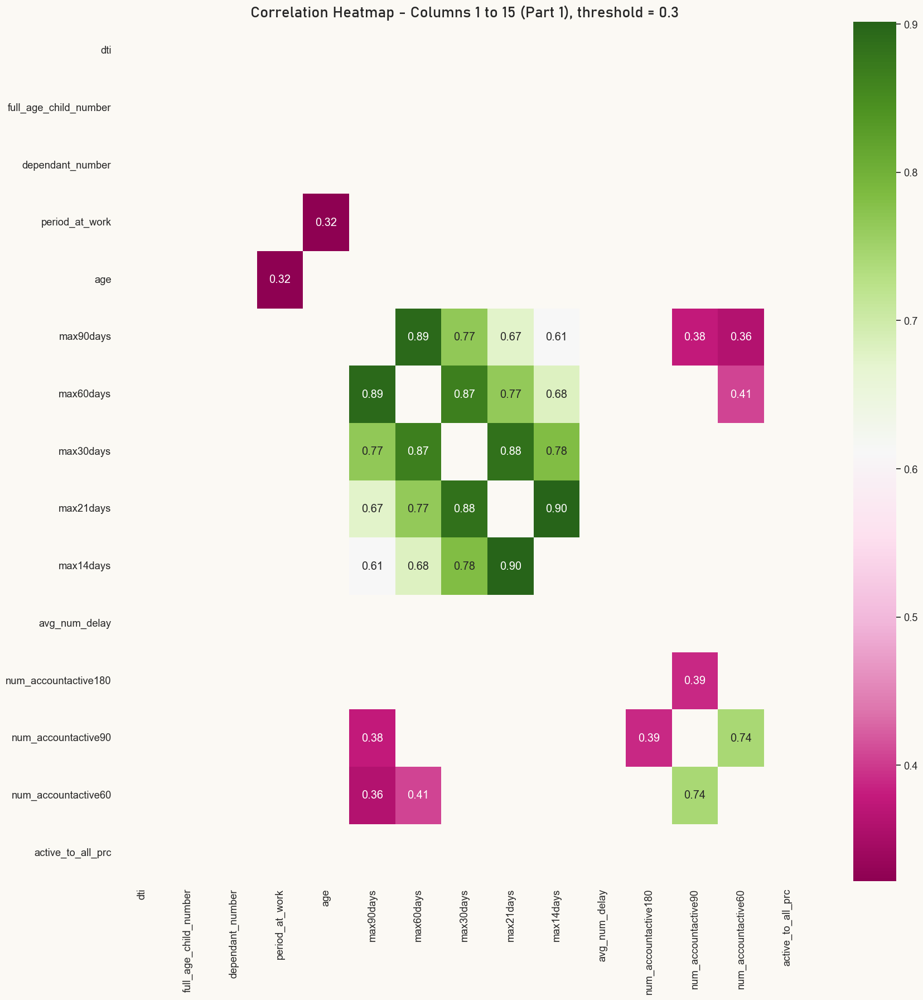

The graph was saved into d:\python\bank-segmentation\heatmaps


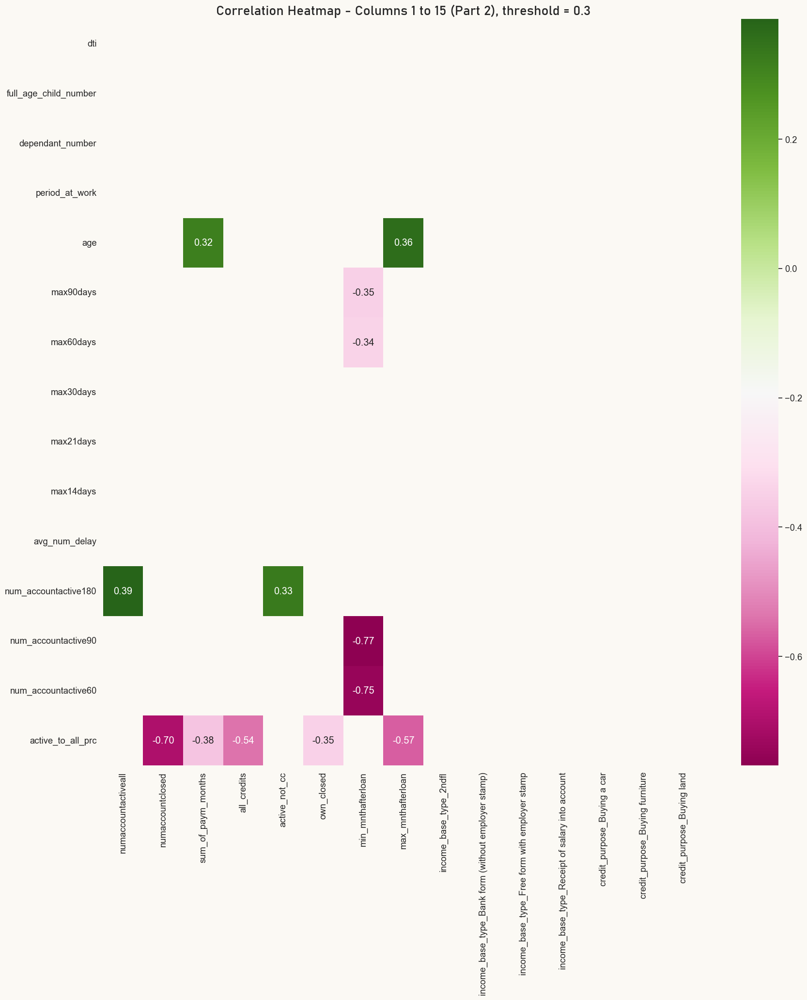

The graph was saved into d:\python\bank-segmentation\heatmaps


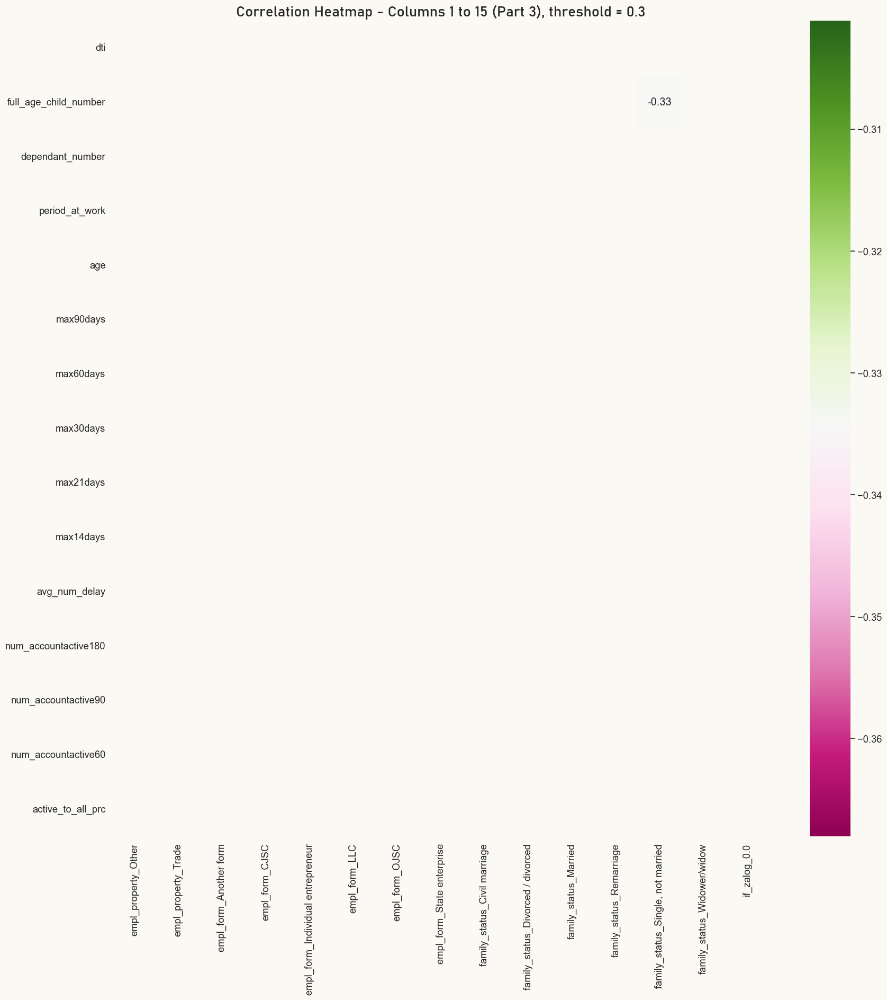

The graph was saved into d:\python\bank-segmentation\heatmaps


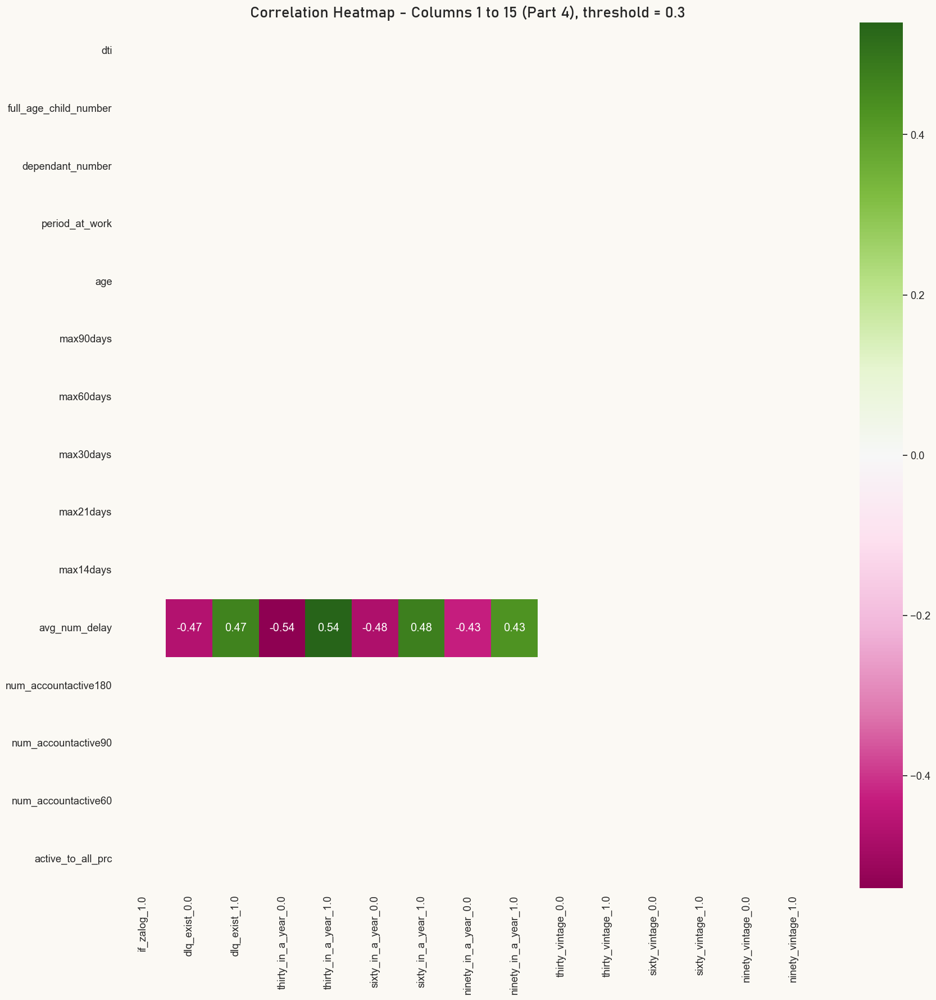

The graph was saved into d:\python\bank-segmentation\heatmaps


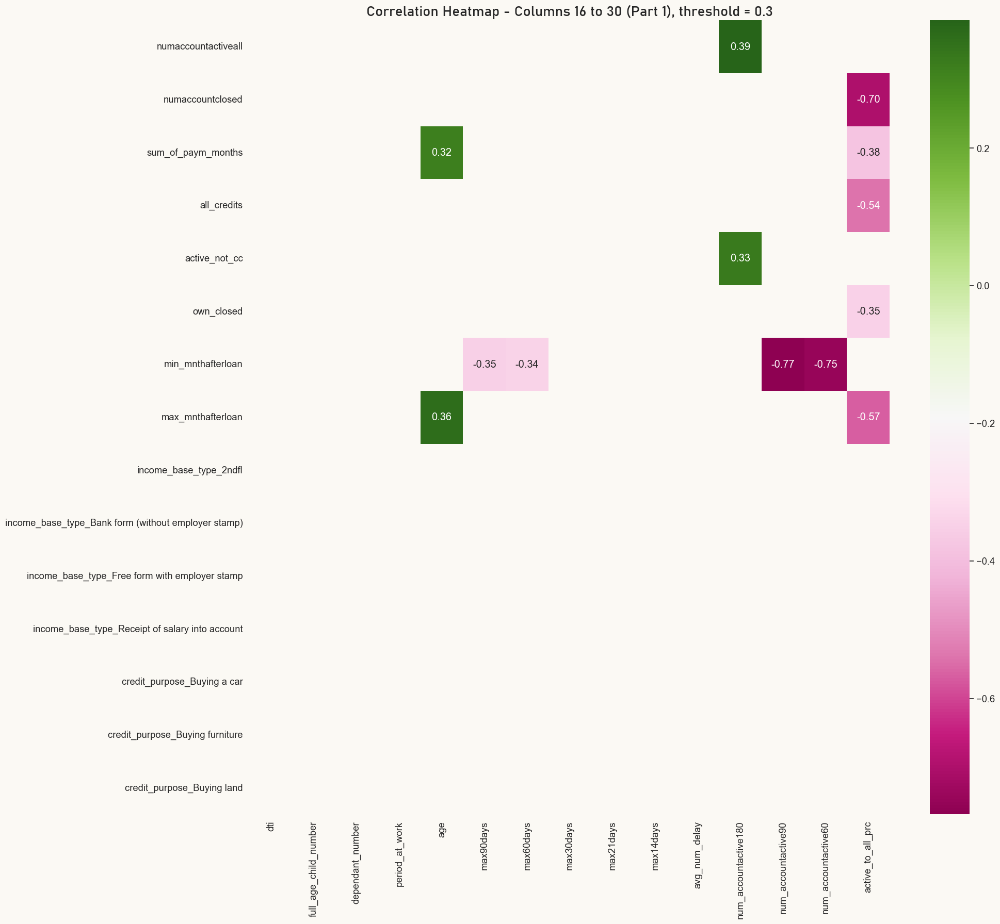

The graph was saved into d:\python\bank-segmentation\heatmaps


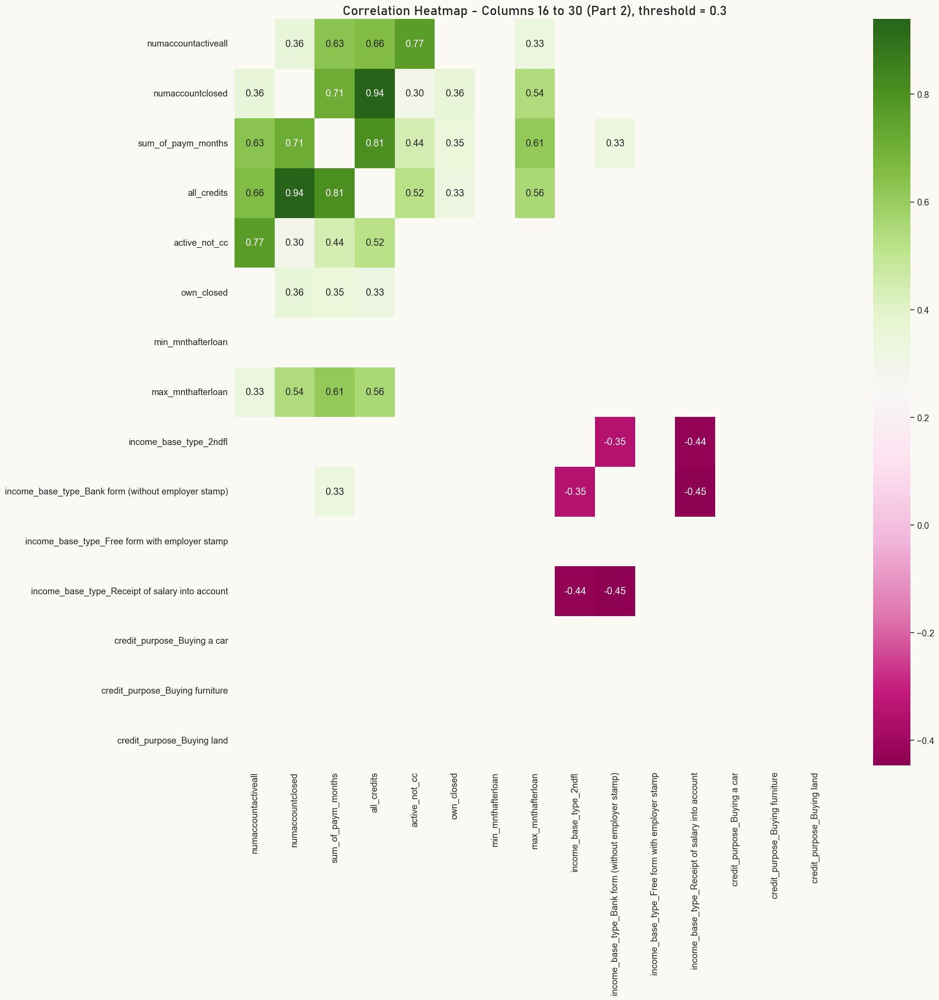

The graph was saved into d:\python\bank-segmentation\heatmaps


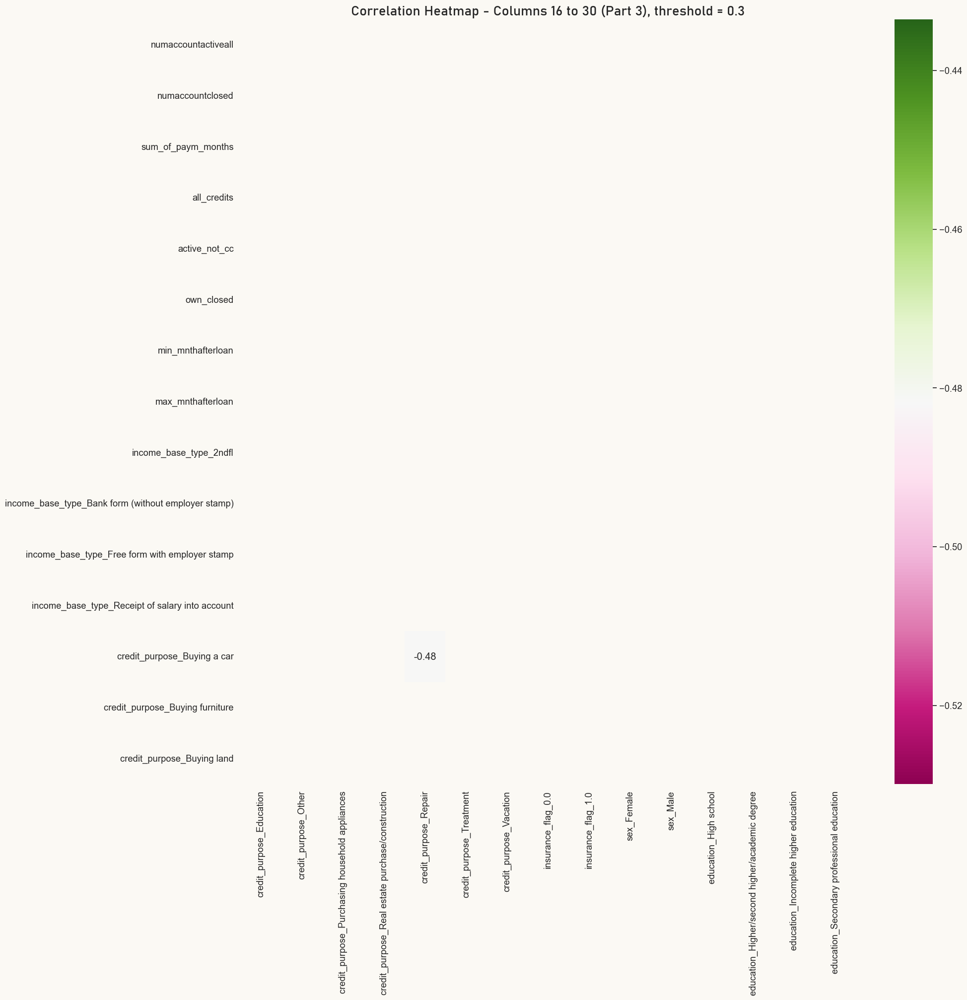

The graph was saved into d:\python\bank-segmentation\heatmaps


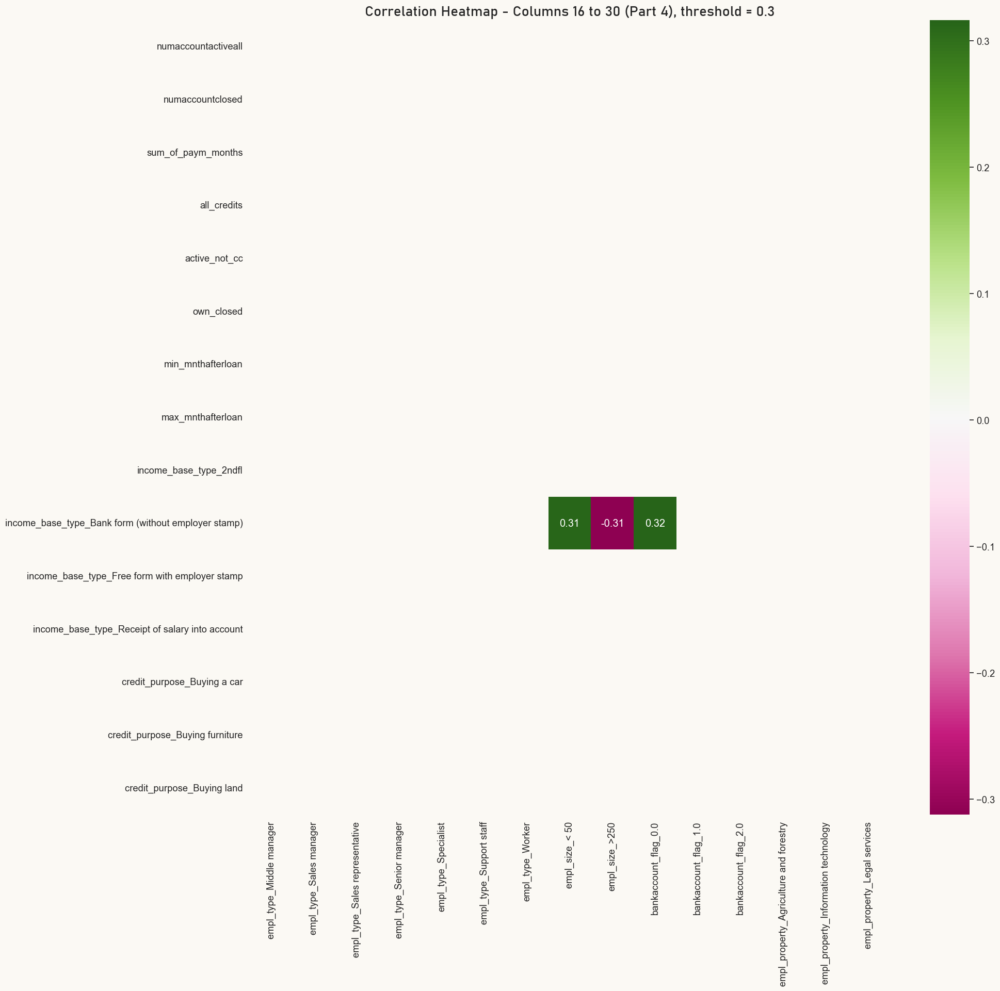

The graph was saved into d:\python\bank-segmentation\heatmaps


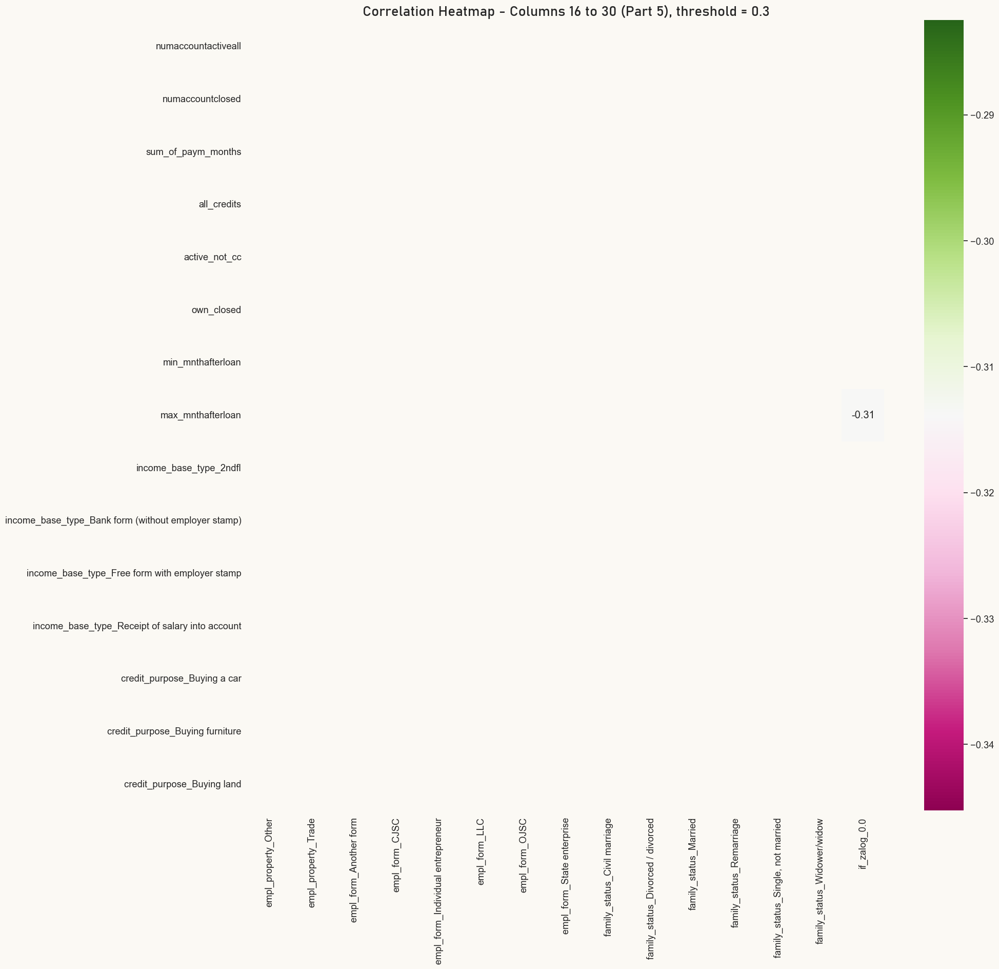

The graph was saved into d:\python\bank-segmentation\heatmaps


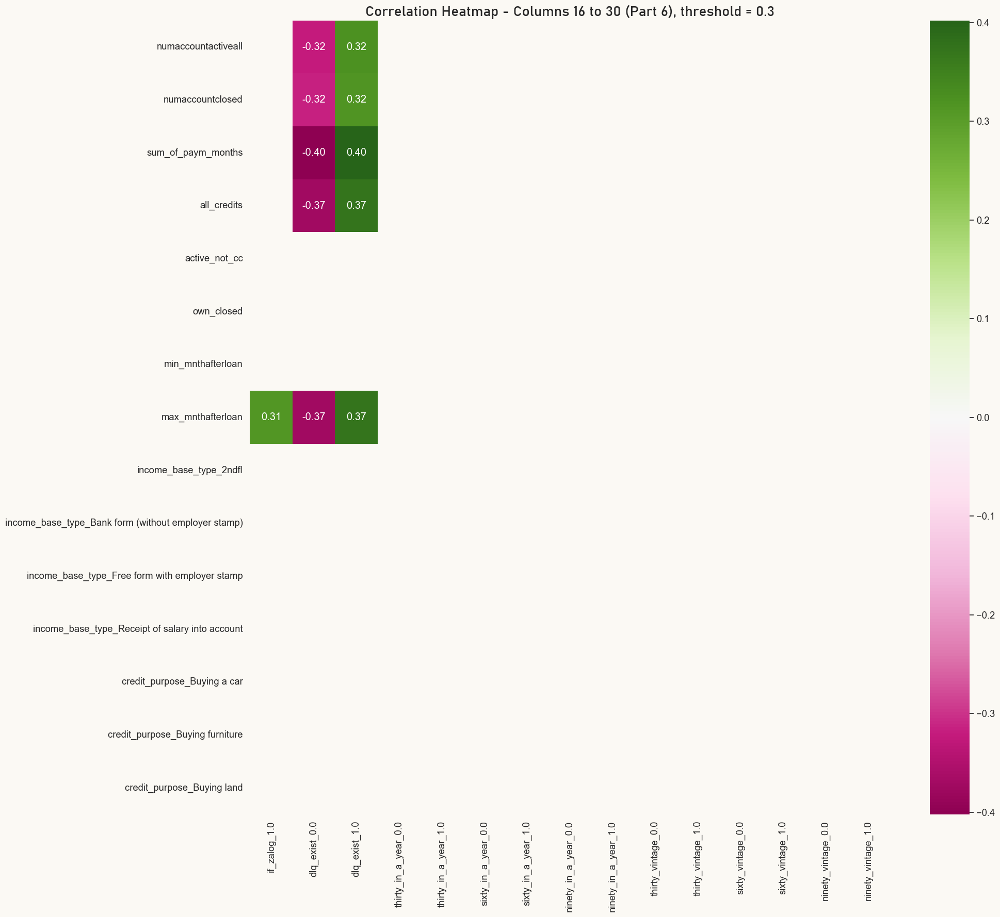

The graph was saved into d:\python\bank-segmentation\heatmaps


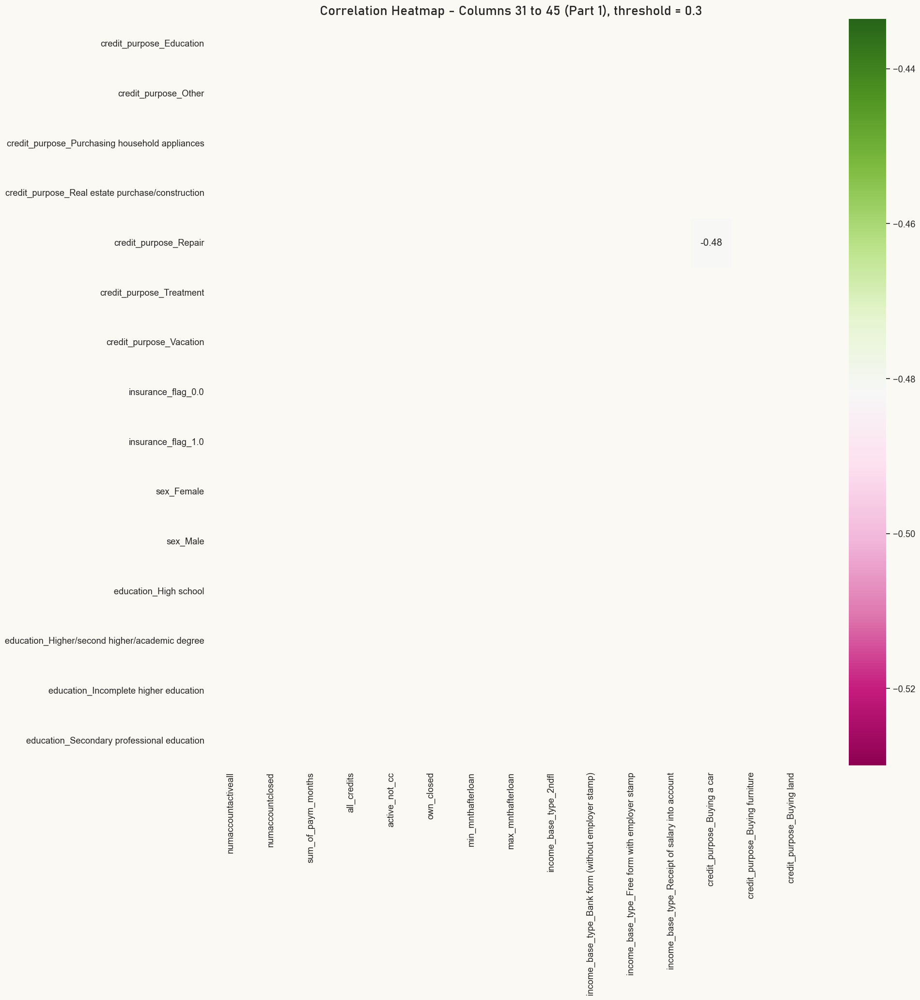

The graph was saved into d:\python\bank-segmentation\heatmaps


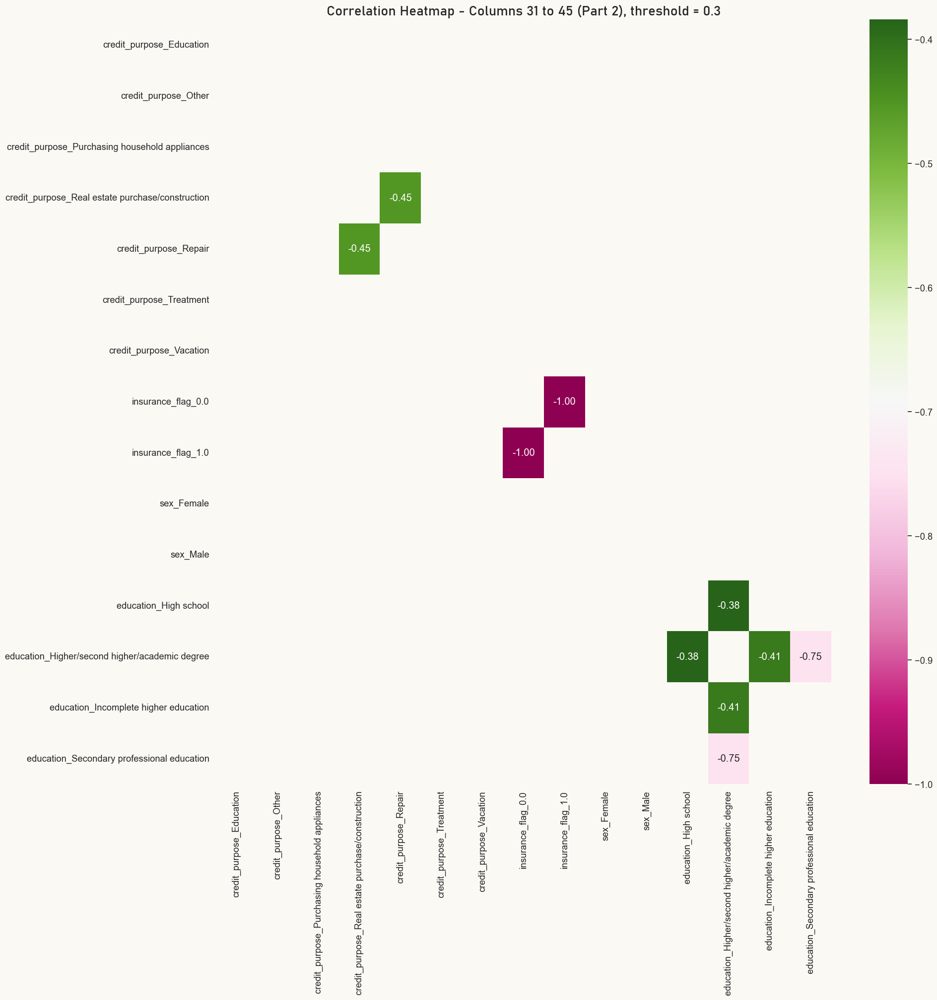

The graph was saved into d:\python\bank-segmentation\heatmaps


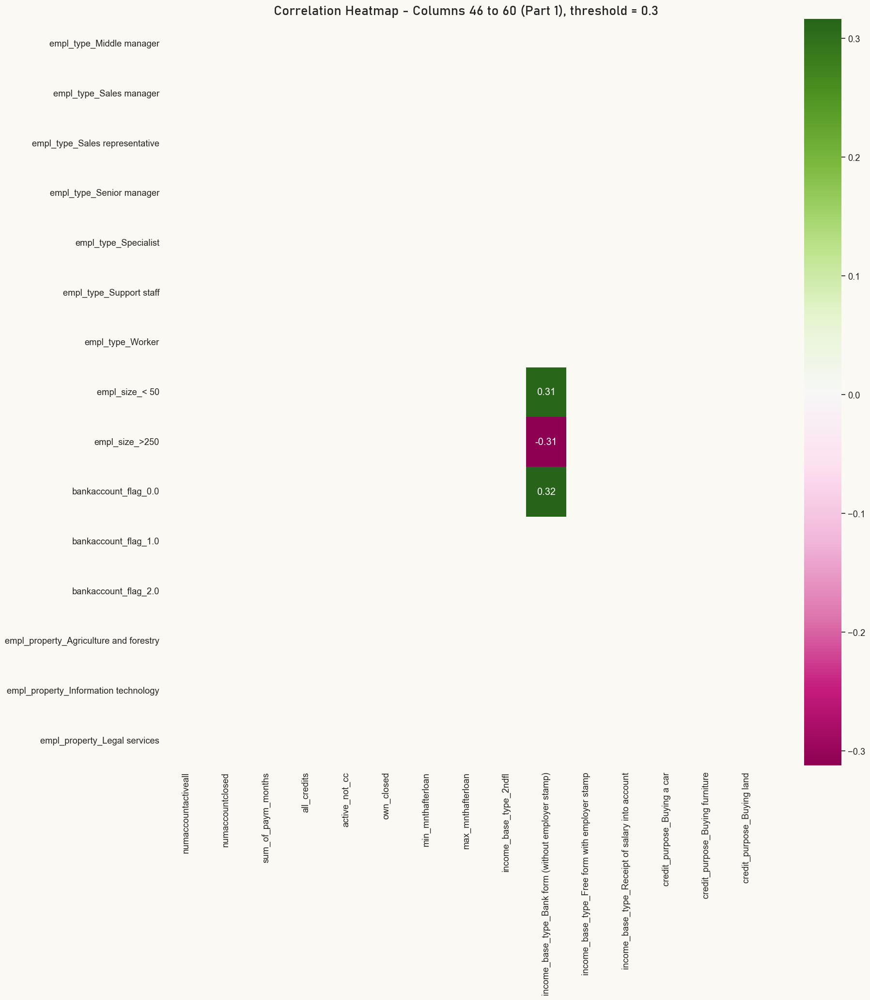

The graph was saved into d:\python\bank-segmentation\heatmaps


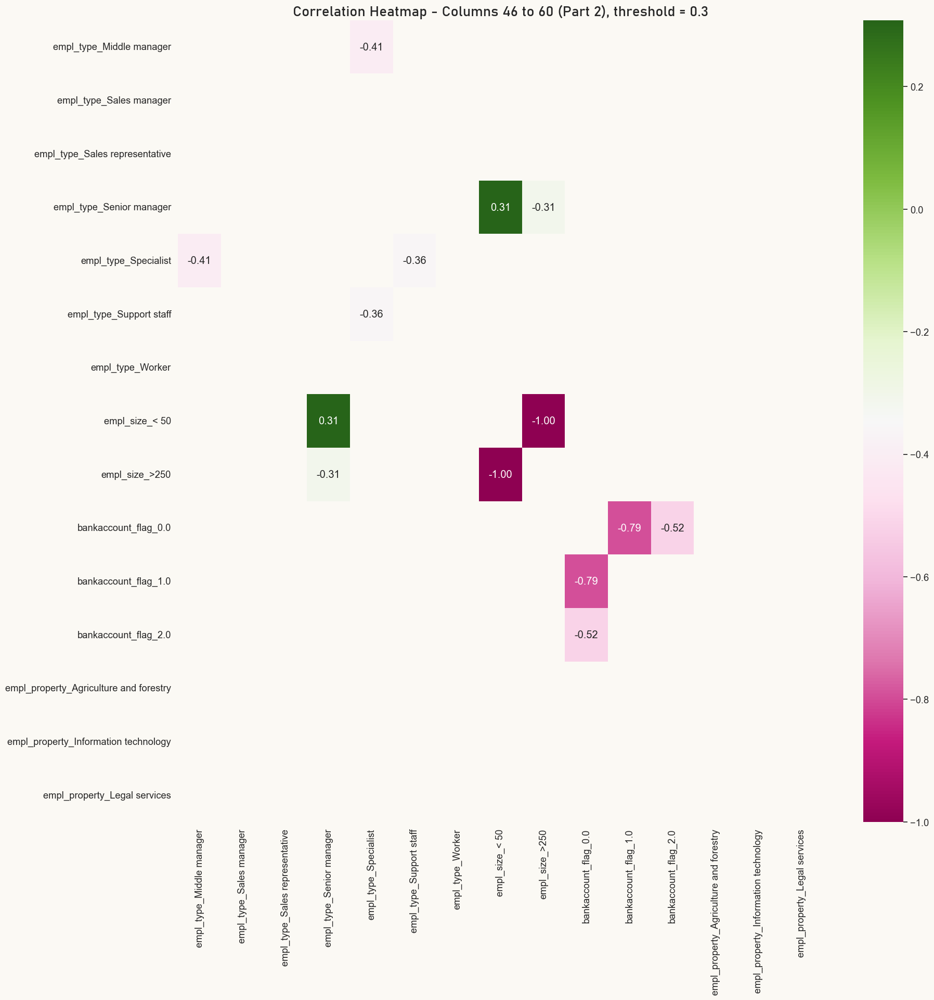

The graph was saved into d:\python\bank-segmentation\heatmaps


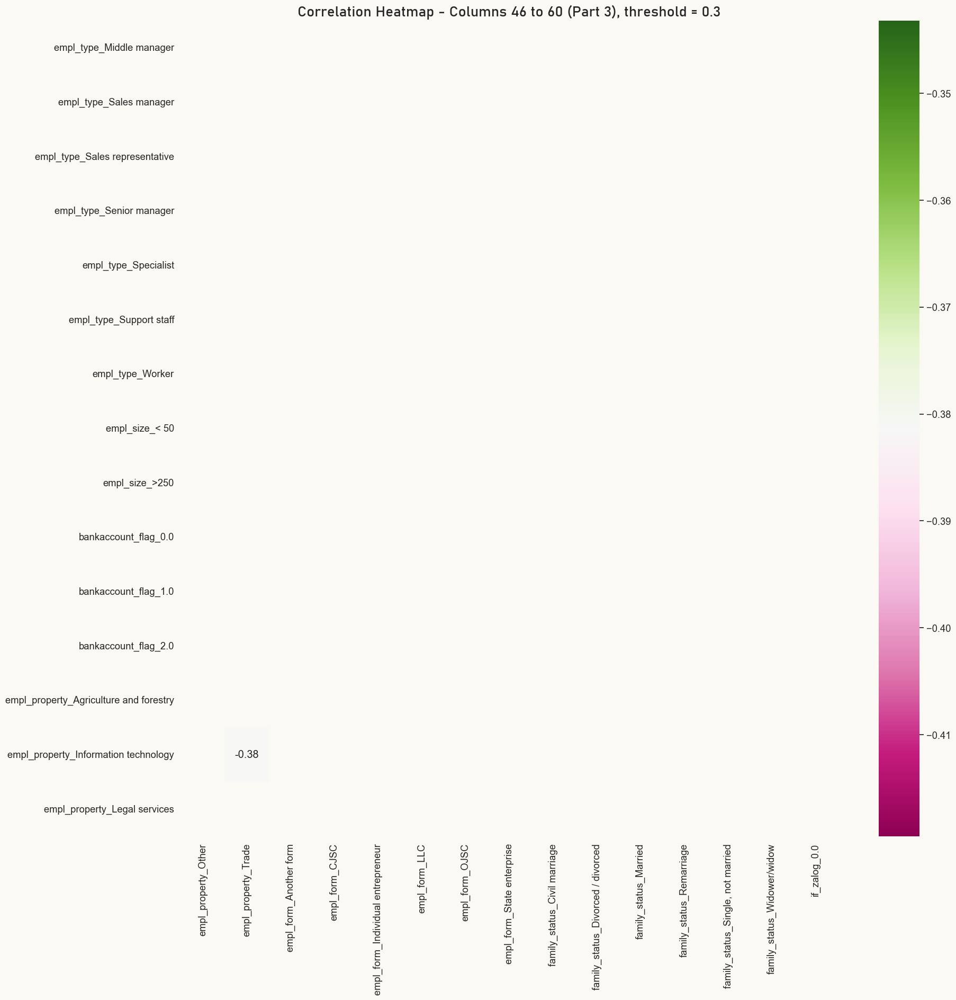

The graph was saved into d:\python\bank-segmentation\heatmaps


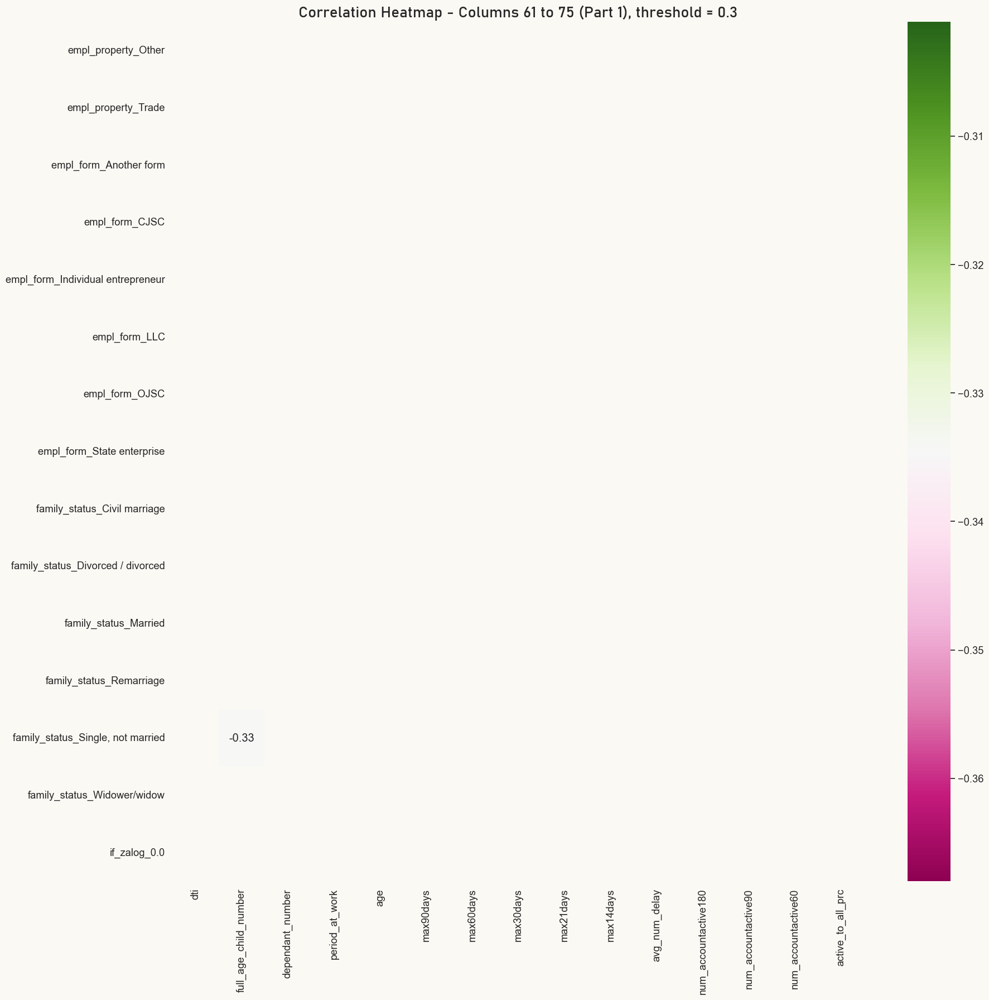

The graph was saved into d:\python\bank-segmentation\heatmaps


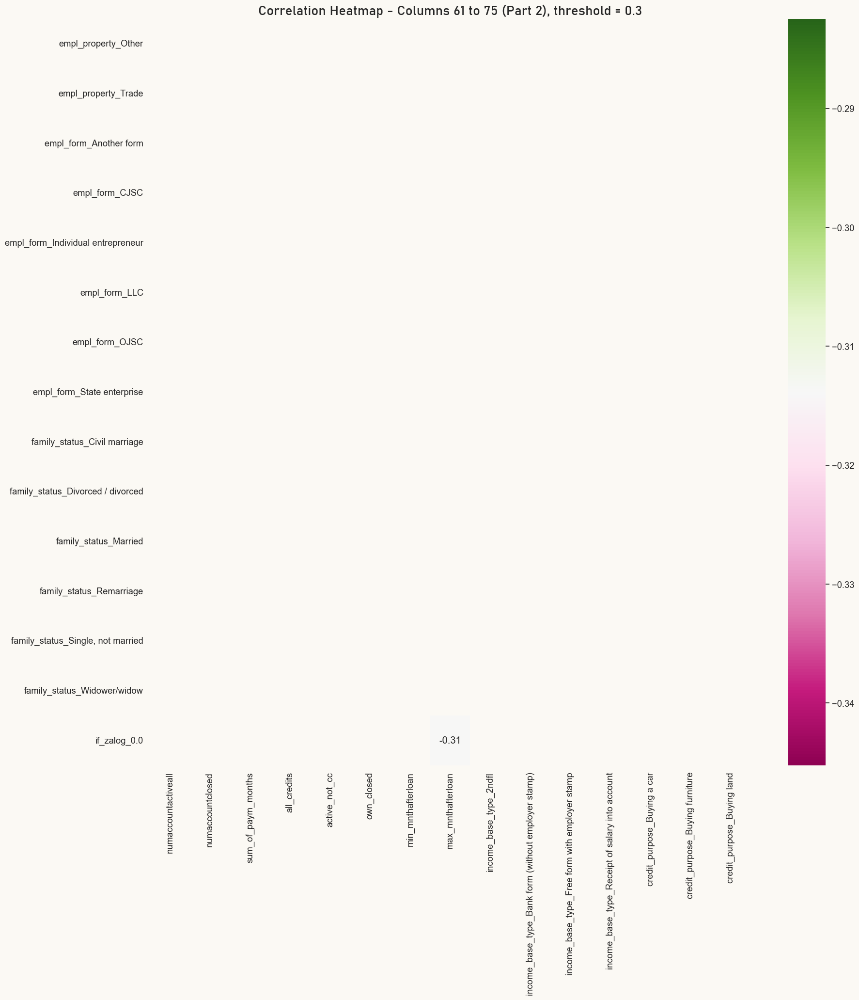

The graph was saved into d:\python\bank-segmentation\heatmaps


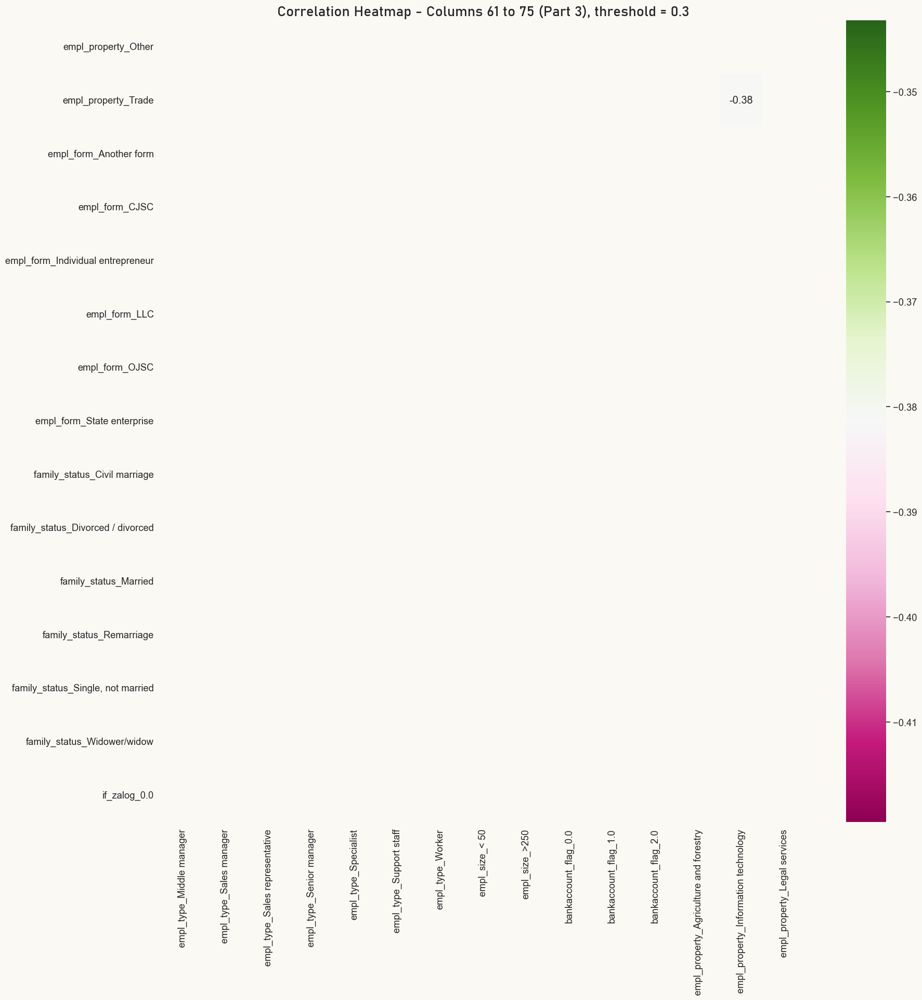

The graph was saved into d:\python\bank-segmentation\heatmaps


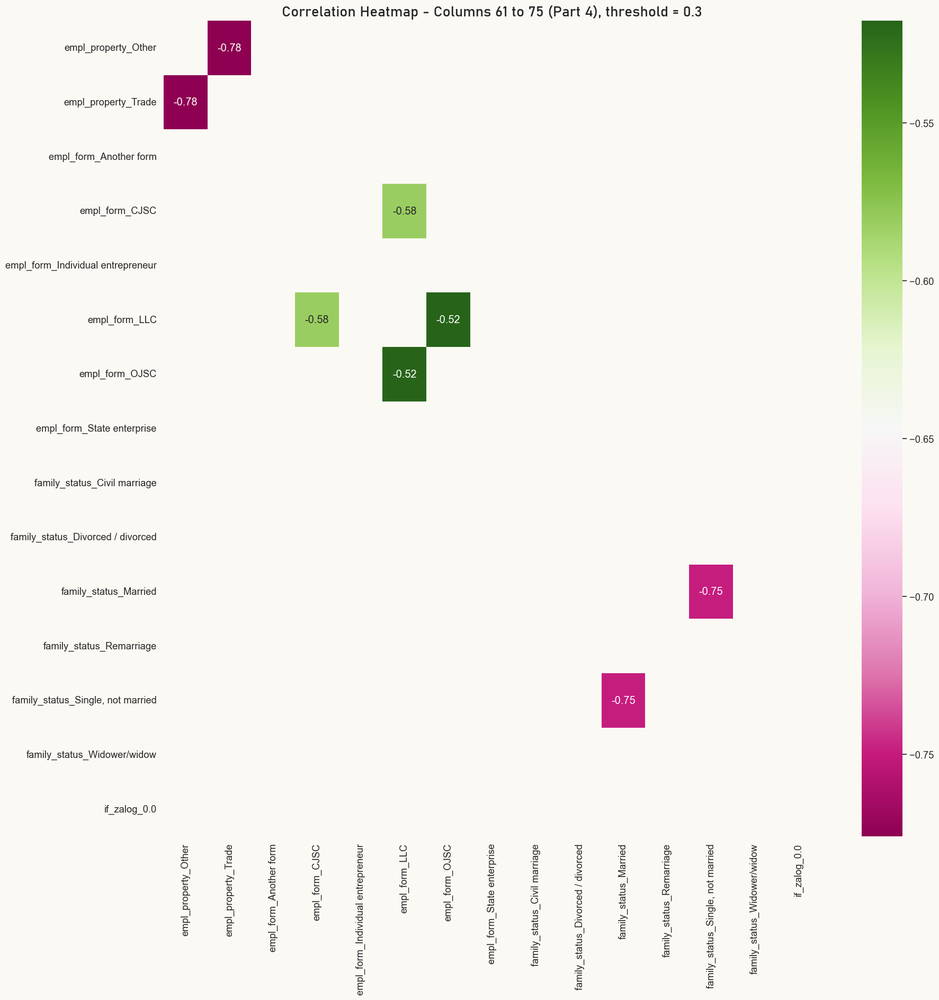

The graph was saved into d:\python\bank-segmentation\heatmaps


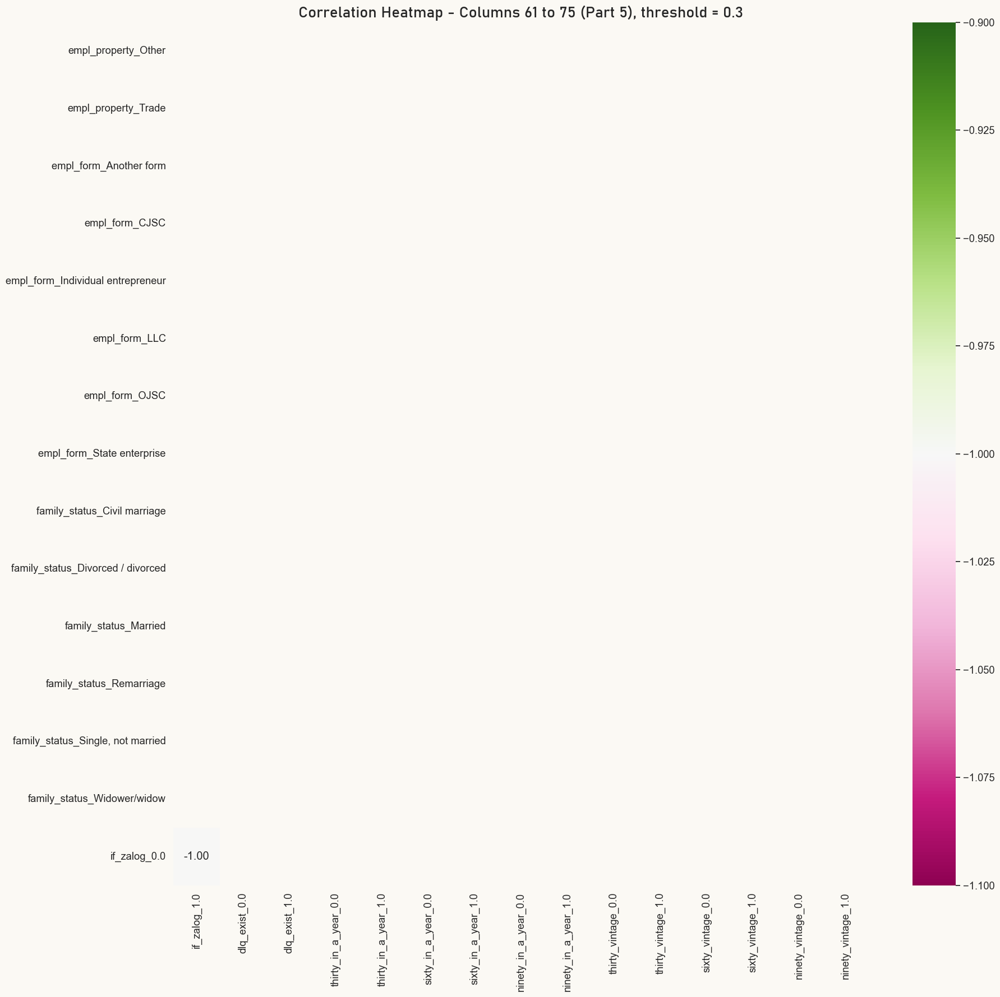

The graph was saved into d:\python\bank-segmentation\heatmaps


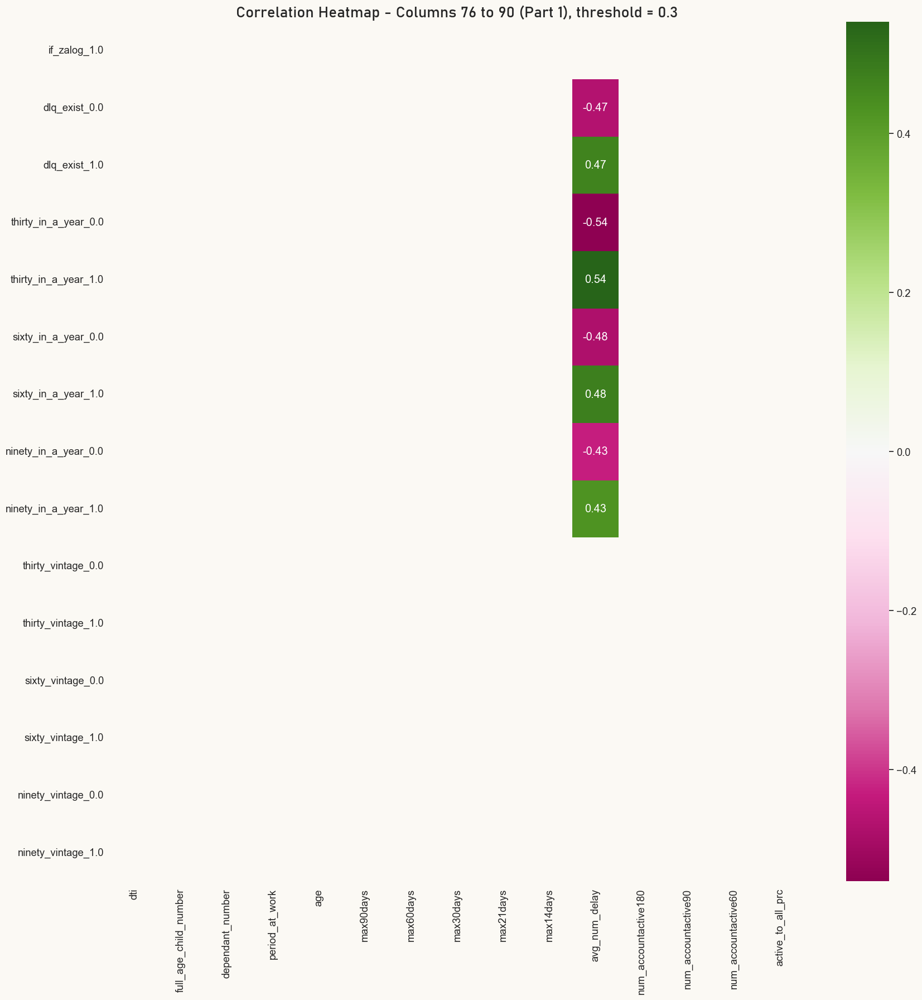

The graph was saved into d:\python\bank-segmentation\heatmaps


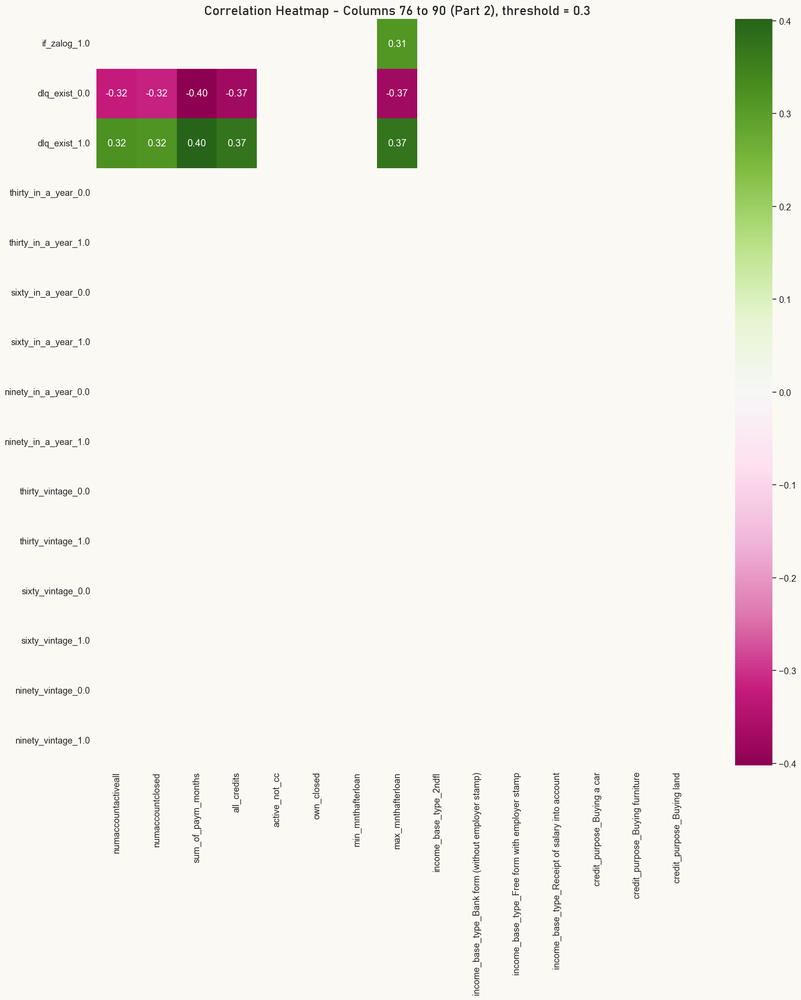

The graph was saved into d:\python\bank-segmentation\heatmaps


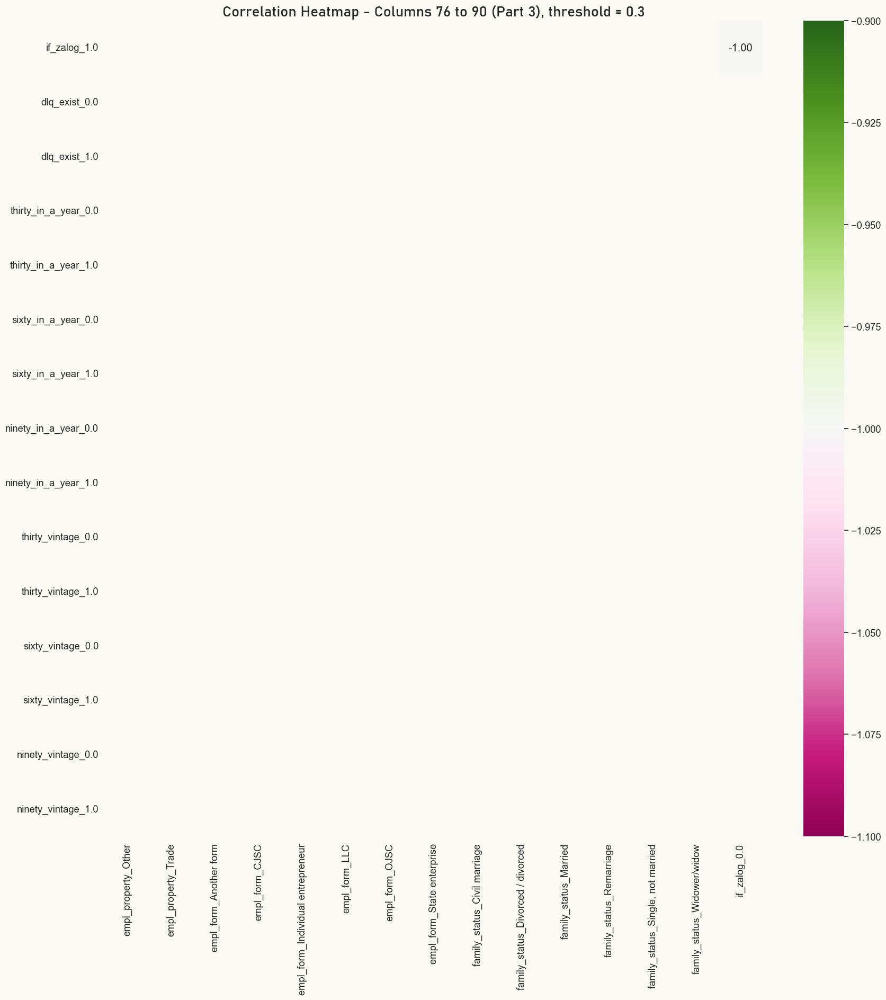

The graph was saved into d:\python\bank-segmentation\heatmaps


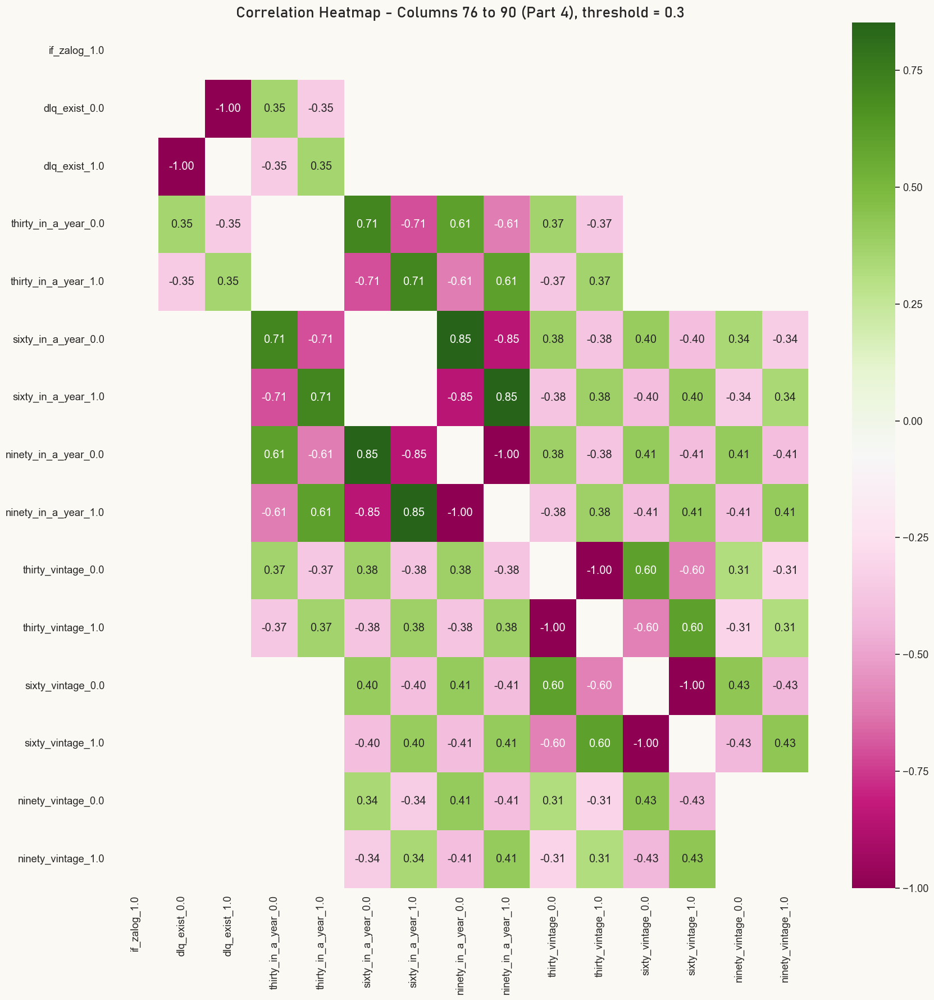

In [27]:
# Some starting parameters
correlation_matrix = onehotdf.corr()
heatmap_segment_size = 15
threshold = 0.3
myfont = "Bahnschrift"

number_of_hmaps = 0
num_columns = len(correlation_matrix.columns)  # number of features
for i in range(0, num_columns, heatmap_segment_size):
    col_sub = 0
    for j in range(0, num_columns, heatmap_segment_size):
        # First corr matrix from 0 to 10 in rows and 0:10 in columns
        # Second corr matrix from 0 to 10 in rows and 10:20 in columns
        subset_corr_matrix = correlation_matrix.iloc[
            i : i + heatmap_segment_size, j : j + heatmap_segment_size
        ]
        # mask = subset_corr_matrix.abs() <= threshold
        mask = (subset_corr_matrix.abs() < threshold) | (subset_corr_matrix.abs() == 1)

        if mask.all().all():
            pass

        else:
            print(f"Creating heatmap №{number_of_hmaps+1}...", end="\r")
            fig, ax = plt.subplots(figsize=(20, 20))
            fig.patch.set_facecolor(BG_WHITE)
            ax.set_facecolor(BG_WHITE)
            ax = sb.heatmap(
                subset_corr_matrix,
                mask=mask,
                annot=True,
                cmap="PiYG",
                fmt=".2f",
            )
            sb.set(font_scale=1.2)

            plt.title(
                "Correlation Heatmap - Columns {} to {} (Part {}), threshold = {}".format(
                    i + 1, i + heatmap_segment_size, col_sub + 1, round(threshold, 2)
                ),
                fontfamily=myfont,
                fontsize=20,
            )
            pngtitle = "hmap_cols_from{}to{}_p{}".format(
                i + 1, i + heatmap_segment_size, col_sub + 1
            )
            save_fig_custom(pic_name=pngtitle, foldertosave="heatmaps")
            plt.show()

            number_of_hmaps += 1
            col_sub += 1

In [ ]:
def get_no_heatmaps(df, hmap_seg_size: int, corr_thr):
    correlation_matrix = df.corr()
    # Set the size of each heatmap segment
    heatmap_segment_size = hmap_seg_size
    number_of_hmaps = 0
    num_columns = len(correlation_matrix.columns)  # number of features
    for i in range(0, num_columns, heatmap_segment_size):
        for j in range(0, num_columns, heatmap_segment_size):
            # First corr matrix from 0 to 10 in rows and 0:10 in columns
            # Second corr matrix from 0 to 10 in rows and 10:20 in columns
            subset_corr_matrix = correlation_matrix.iloc[
                i : i + heatmap_segment_size, j : j + heatmap_segment_size
            ]

            mask = (subset_corr_matrix.abs() <= corr_thr) | (
                subset_corr_matrix.abs() == 1
            )
            if mask.all().all():
                pass
            else:
                number_of_hmaps += 1

    return number_of_hmaps


threshold = 0.3
get_no_heatmaps(df=onehotdf, hmap_seg_size=15, corr_thr=threshold)

24

In [ ]:
# j - for column index
# i - for row index
fig = plt.figure(figsize=(200, 200))
fig.patch.set_facecolor(BG_WHITE)
threshold = 0.3
correlation_matrix = onehotdf.corr()
# Set the size of each heatmap segment
heatmap_segment_size = 15
number_of_hmaps = 0
sb.set(font_scale=3)
num_columns = len(correlation_matrix.columns)  # number of features
for i in range(0, num_columns, heatmap_segment_size):
    col_sub = 0
    for j in range(0, num_columns, heatmap_segment_size):
        # First corr matrix from 0 to 10 in rows and 0:10 in columns
        # Second corr matrix from 0 to 10 in rows and 10:20 in columns
        subset_corr_matrix = correlation_matrix.iloc[
            i : i + heatmap_segment_size, j : j + heatmap_segment_size
        ]
        mask = (subset_corr_matrix.abs() < threshold) | (subset_corr_matrix.abs() == 1)
        if mask.all().all():
            pass
        else:
            ax = plt.subplot(6, 4, number_of_hmaps + 1)
            ax.set_facecolor(BG_WHITE)
            print(f"Creating heatmap №{number_of_hmaps+1}...", end="\r")
            sb.heatmap(
                subset_corr_matrix,
                annot=True,
                cmap="PiYG",
                mask=mask,
                fmt=".2f",
            )

            ax.set_title(
                "Correlation Heatmap - Columns {} to {} (Part {})".format(
                    i + 1, i + heatmap_segment_size, col_sub + 1
                ),
                fontfamily=myfont,
                fontsize=40,
            )
            number_of_hmaps += 1
            col_sub += 1

fig.tight_layout()
save_fig_custom(pic_name="heatmaps_all", foldertosave="heatmaps")

The graph was saved into d:\python\bank-segmentation\heatmaps


# **Segmentation**

## K-means clustering

- First method I'm going to use is k-means clustering. I'm going to cluster customers based on the following features: sex, age, family status, salary and education.

- The first thing I need to do is to scale the data, then identify number of clusters k. 
Then proceed to selecting k random point whithin the data which are going to be our initial cluster centers (centroids). After that distance between centroids and each point of the data should be calculated, and so each point will be assigned to the cluster with shortest distance to it. Next step is to calculate mean of each cluster and treat it as a new cluster centroid and reassign points with respect to new centroids. Last to steps will be repeated until data points stop jumping between updated cluster centroids.

In [ ]:
kmean_f = [
    "sex_Female",
    "sex_Male",
    "family_status_Civil marriage",
    "family_status_Divorced / divorced",
    "family_status_Married",
    "family_status_Remarriage",
    "family_status_Single, not married",
    "family_status_Widower/widow",
    "empl_size_< 50",
    "empl_size_>250",
    "education_High school",
    "education_Higher/second higher/academic degree",
    "education_Incomplete higher education",
    "education_Secondary professional education",
    "age",
]

In [ ]:
km_df = onehotdf[kmean_f]

In [ ]:
km_df.head(5)

,sex_Female,sex_Male,family_status_Civil marriage,family_status_Divorced / divorced,family_status_Married,family_status_Remarriage,"family_status_Single, not married",family_status_Widower/widow,empl_size_< 50,empl_size_>250,education_High school,education_Higher/second higher/academic degree,education_Incomplete higher education,education_Secondary professional education,age
1,1,0,0,0,1,0,0,0,1,0,0,1,0,0,37.0
15,0,1,0,0,0,0,1,0,0,1,0,1,0,0,39.0
16,0,1,0,0,1,0,0,0,0,1,0,1,0,0,26.0
24,1,0,0,0,0,0,1,0,0,1,0,1,0,0,52.0
25,0,1,0,0,0,0,1,0,0,1,1,0,0,0,46.0


### Normalising data

In [ ]:
norm_df = (km_df - km_df.min()) / (km_df.max() - km_df.min())
norm_df.head(10)

,sex_Female,sex_Male,family_status_Civil marriage,family_status_Divorced / divorced,family_status_Married,family_status_Remarriage,"family_status_Single, not married",family_status_Widower/widow,empl_size_< 50,empl_size_>250,education_High school,education_Higher/second higher/academic degree,education_Incomplete higher education,education_Secondary professional education,age
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.388916
15,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.444336
16,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.083313
24,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.805664
25,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.638672
43,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.444336
50,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.194458
55,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.222168
57,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.222168
74,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.333252


### Choosing optimal number of clusters

In [ ]:
# WCSS -> Within Clusters Sum of Squares
## Elbow method
wcss = []

for i in range(1, 11):  # Try k from 1 to 10
    kmeans = KMeans(n_clusters=i, init="k-means++", random_state=123, n_init=30)
    kmeans.fit(norm_df)

    wcss.append(kmeans.inertia_)

c:\Users\melko\AppData\Local\Programs\Python\Python39\lib\site-packages\joblib\externals\loky\backend\context.py:110: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\melko\AppData\Local\Programs\Python\Python39\lib\site-packages\joblib\externals\loky\backend\context.py", line 217, in _count_physical_cores
    raise ValueError(


The graph was saved into d:\python\bank-segmentation\kmeans_vis


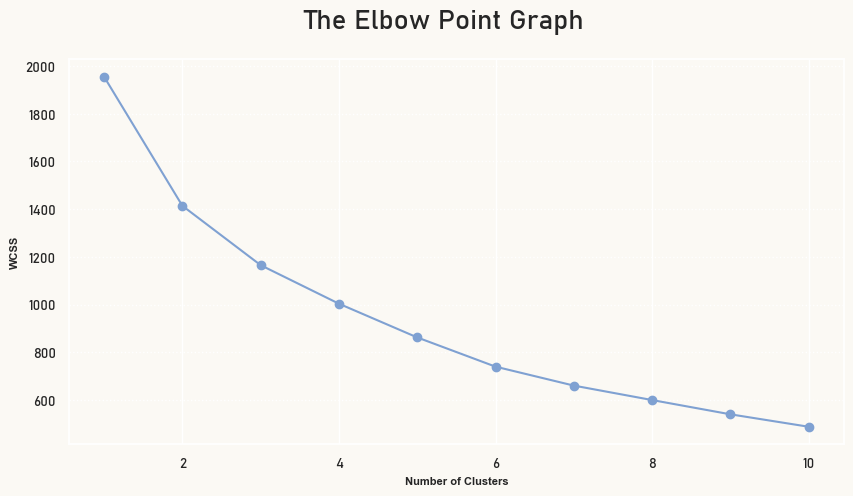

In [ ]:
fig, ax = plt.subplots(figsize=(10, 5))
# General parameters for fiqure and axes
fig.patch.set_facecolor(BG_WHITE)
ax.set_facecolor(BG_WHITE)
## Title
fig.suptitle(
    "The Elbow Point Graph",
    fontfamily=myfont,
    fontweight="bold",
    fontsize=20,
)

# Prepare values
yvals = wcss
xvals = range(1, 11)

# Graph
ax.plot(xvals, yvals, color=BLUE, marker="o")

# Axis params
ax.set_xlabel("Number of Clusters", fontsize=8, fontweight="bold")
ax.set_ylabel("WCSS", fontsize=8, fontweight="bold")
ax.grid(linestyle=":", linewidth=1, axis="y")
ax.tick_params(axis="both", which="major", labelsize=10)
##Font
for tick in ax.get_xticklabels():
    tick.set_fontname(myfont)
for tick in ax.get_yticklabels():
    tick.set_fontname(myfont)

save_fig_custom(pic_name="elbow_gr", foldertosave="kmeans_vis")

### Running K-means

From this graph we can see that optimal number of clusters is 6 as after 6 clusters the drop in WCSS is not that significant.

In [ ]:
model = KMeans(n_clusters=6, init="k-means++", n_init=30, random_state=123).fit(norm_df)
# Return labels for each data point based on their cluster
print("Clusters", model.labels_)

Clusters [5 4 3 ... 1 3 3]


In [ ]:
# Copy normalised dataset
cluster_df = norm_df.copy()
cluster = model.fit_predict(norm_df)
cluster_df["Cluster"] = cluster
cluster_df.head()

,sex_Female,sex_Male,family_status_Civil marriage,family_status_Divorced / divorced,family_status_Married,family_status_Remarriage,"family_status_Single, not married",family_status_Widower/widow,empl_size_< 50,empl_size_>250,education_High school,education_Higher/second higher/academic degree,education_Incomplete higher education,education_Secondary professional education,age,Cluster
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.388916,5
15,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.444336,4
16,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.083313,3
24,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.805664,2
25,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.638672,4


In [ ]:
km_cl_f = kmean_f
km_cl_f.append("Cluster")
print(km_cl_f)

['sex_Female', 'sex_Male', 'family_status_Civil marriage', 'family_status_Divorced / divorced', 'family_status_Married', 'family_status_Remarriage', 'family_status_Single, not married', 'family_status_Widower/widow', 'empl_size_< 50', 'empl_size_>250', 'education_High school', 'education_Higher/second higher/academic degree', 'education_Incomplete higher education', 'education_Secondary professional education', 'age', 'Cluster']


In [ ]:
cluster_df[km_cl_f]

,sex_Female,sex_Male,family_status_Civil marriage,family_status_Divorced / divorced,family_status_Married,family_status_Remarriage,"family_status_Single, not married",family_status_Widower/widow,empl_size_< 50,empl_size_>250,education_High school,education_Higher/second higher/academic degree,education_Incomplete higher education,education_Secondary professional education,age,Cluster
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.388916,5
15,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.444336,4
16,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.083313,3
24,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.805664,2
25,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.638672,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10204,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.305664,5
10218,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.388916,3
10221,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.472168,1
10225,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.111084,3


### Clusters Visualisation

However, I need a way to depict clusters ans I'm going to do it using Parallel Coordinates plot as it allows to visualize multidimesional data. Moreover, it will be useful in understanding each cluster group. I will start with adding cluster number to each row.

In [ ]:
vis_f = ["sex", "family_status", "empl_size", "education", "age", "cluster"]


vis_df = sorted_df.copy()
vis_df["cluster"] = cluster
vis_df = vis_df[vis_f]
vis_df.cluster = vis_df.cluster.astype(str)

The graph was saved into d:\python\bank-segmentation\kmeans_vis
The graph was saved into d:\python\bank-segmentation\kmeans_vis
The graph was saved into d:\python\bank-segmentation\kmeans_vis
The graph was saved into d:\python\bank-segmentation\kmeans_vis
The graph was saved into d:\python\bank-segmentation\kmeans_vis
The graph was saved into d:\python\bank-segmentation\kmeans_vis


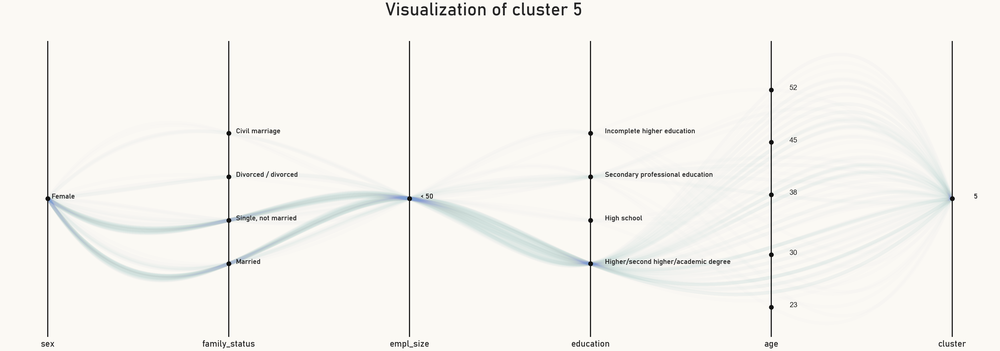

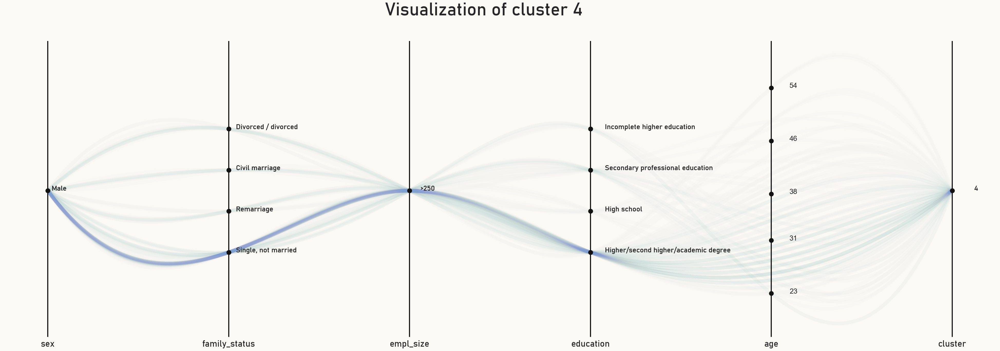

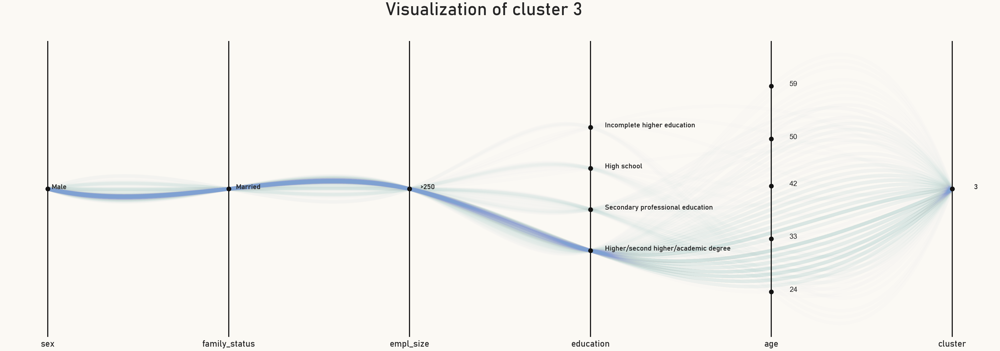

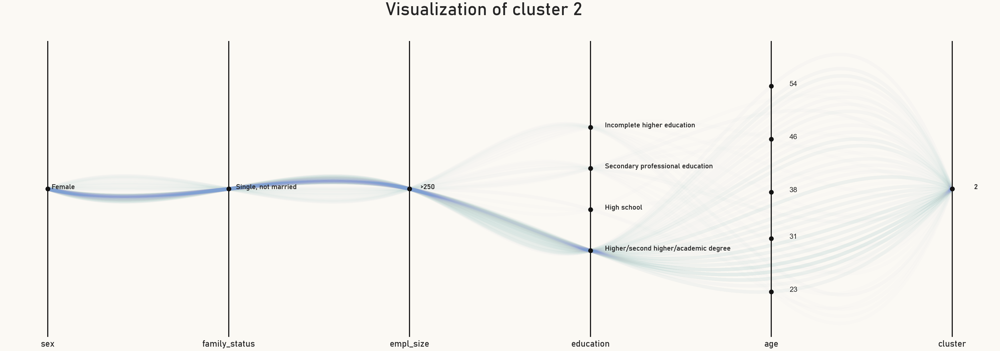

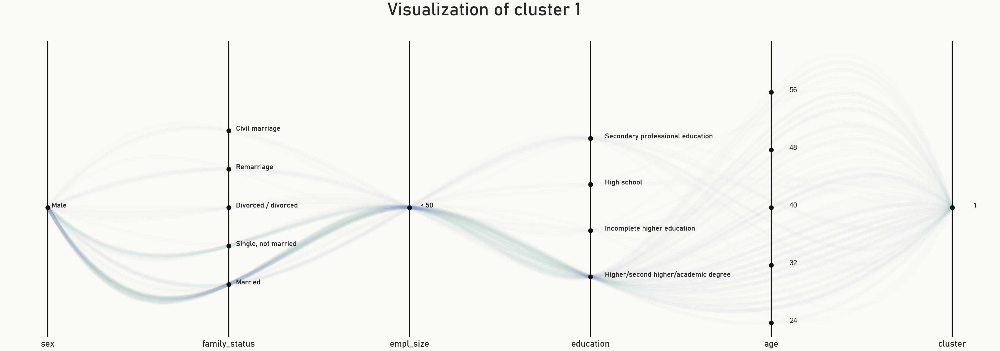

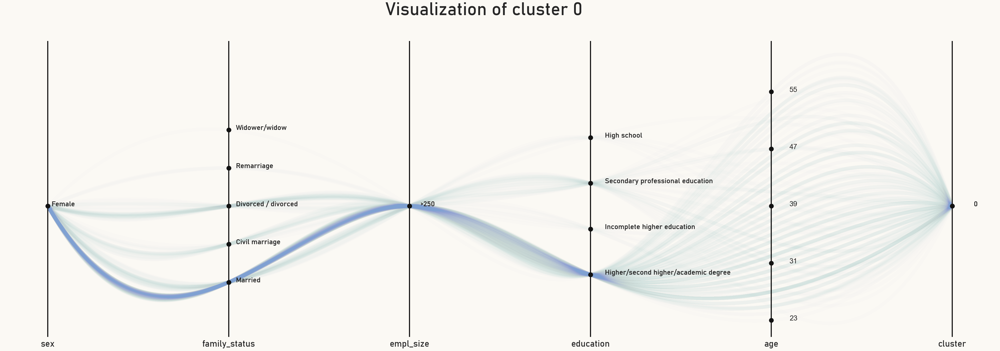

In [ ]:
from datavis_colors import *

for cl in vis_df.cluster.unique():
    subdf = vis_df.loc[vis_df.cluster == cl]
    fig, ax = parallel_coordinates_custom(
        df=subdf, title_text="Visualization of cluster {}".format(cl)
    )
    save_fig_custom(pic_name=f"cluster_{cl}", foldertosave="kmeans_vis")

The graph was saved into d:\python\bank-segmentation\kmeans_vis


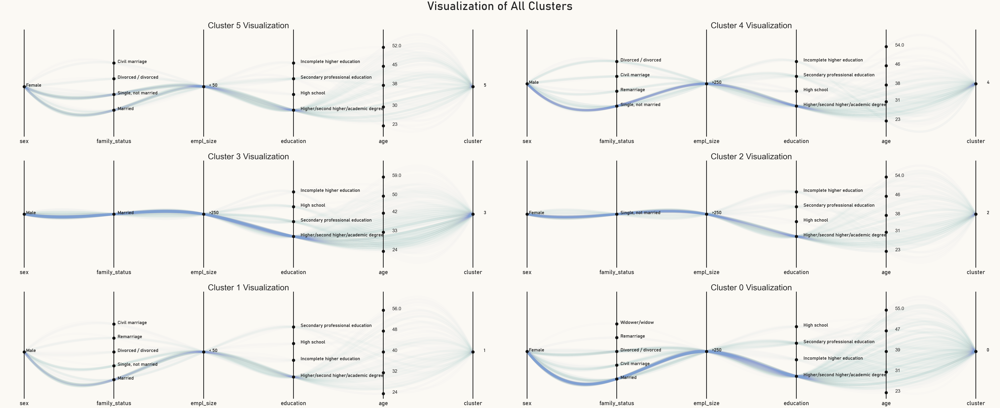

In [ ]:
cl_list = vis_df.cluster.unique()
fig = plt.figure(figsize=(60, 25))
fig.patch.set_facecolor(BG_WHITE)
fig.suptitle(
    "Clusters Visualization",
    fontname=myfont,
    fontsize=50,
    weight="bold",
    ha="center",
)

for cl in enumerate(cl_list):
    subdf = vis_df.loc[vis_df.cluster == cl[1]]
    axes = subdf.columns
    df = subdf

    ax = plt.subplot(3, 2, cl[0] + 1)
    ax.grid(axis="y", linestyle=":", linewidth=5)
    cat_cord = {}
    num_min_max = {}
    numerics = ["int64", "int32", "int16", "float64", "float32", "float16", "float"]

    # Create additional axes
    for i in range(len(axes)):  # i - column order number of orig df
        ax.axvline(x=i + 1, linewidth=3, color="#121212", zorder=8)
        ax.set_facecolor(BG_WHITE)
        ax.spines["right"].set_visible(False)
        ax.spines["top"].set_visible(False)
        ax.spines["bottom"].set_visible(False)
        ax.spines["left"].set_visible(False)

        ax.get_yaxis().set_visible(False)
        # Add axes for each dimension
        ax.set_xticks(
            ticks=range(1, len(axes) + 1, 1),
            labels=axes.values,
            size=25,
            fontfamily=myfont,
        )
        # Non-numeric columns
        if df[axes[i]].dtype not in numerics:
            # print(True)
            cat_list = df[axes[i]].unique().tolist()
            add = 1 / (len(cat_list) + 1)
            colcat_dict = {}
            for j in range(len(cat_list)):  # j - order number for cat within cat column
                yparam = add * (j + 1)
                colcat_dict[cat_list[j]] = yparam
                # Plot cat variables on axes
                ax.scatter(i + 1, yparam, s=150, zorder=10, c="#121212")
                # add categories to axes
                ax.text((i + 1) * 1.02, yparam, cat_list[j], size=20, fontfamily=myfont)
                cat_cord[df.columns[i]] = colcat_dict
                ax.scatter(i + 1, yparam, s=150, zorder=10, c="#121212")
                # add categories to axes
                ax.text((i + 1) * 1.02, yparam, cat_list[j], size=20, fontfamily=myfont)
                yparam += yparam

        else:
            # Ticks for numerical values
            col_min, col_max = df[axes[i]].min(), df[axes[i]].max()
            num_tick_dict = set_num_ax_ticks(df[axes[i]].values, col_min, col_max)
            for key in num_tick_dict:
                ax.scatter(i + 1, num_tick_dict[key], s=150, zorder=10, c="#121212")
                ax.text((i + 1) * 1.02, num_tick_dict[key], key, size=20)
    # Adding values
    transp_df = df.transpose().reset_index()
    transp_df = transp_df.drop(columns=transp_df.columns[0])

    for col in transp_df.columns:
        line = transp_df[col].tolist()
        xvals = []
        yvals = []
        # print(line)

        for ent in enumerate(line):
            xvals.append(ent[0] + 1)
            # If categorical data
            if df.columns[ent[0]] in cat_cord:
                # print(f"NOT NUMERIC: {ent[1], type(ent[1])}")
                """
                print(
                    "Corresponding y-value:",
                    cat_cord[df.columns[ent[0]]][ent[1]],
                    "Entry value:",
                    ent[1],
                    "Column name:",
                    df.columns[ent[0]],
                )
                """
                yvals.append(cat_cord[df.columns[ent[0]]][ent[1]])

            else:
                pass
                sc_y = norm_val(
                    ent[1],
                    min(df.iloc[:, ent[0]].values),
                    max(df.iloc[:, ent[0]].values),
                )

                yvals.append(sc_y)

        # print(f"Line x-values: {xvals}\n Line y-values: {yvals}")
        # print(f"x-values: {xvals}, y-values: {yvals}")
        X_Y_Spline = make_interp_spline(np.array(xvals), np.array(yvals))

        # Returns evenly spaced numbers
        # over a specified interval.
        X_ = np.linspace(np.array(xvals).min(), np.array(xvals).max(), 500)
        Y_ = X_Y_Spline(X_)
        ax.plot(X_, Y_, alpha=0.01, linewidth=10, c=BLUE)
        ax.set_title(f"Cluster {cl[1]} Visualization", fontsize=35)

        fig.suptitle(
            "Visualization of All Clusters",
            fontfamily=myfont,
            size=50,
            fontweight="bold",
        )
        fig.tight_layout()


def norm_val(val, minv, maxv):
    res = (val - minv) / (maxv - minv)
    return res


save_fig_custom(pic_name="all_clusters", foldertosave="kmeans_vis")

### Description of Clusters

- Cluster 0 consists of married women of different ages who earn more than 250k rubles with bachelor's/master's/PhD degrees.

- Cluster 1 consists of  married men of different ages who earn less than 50k rubles with bachelor's/master's/PhD degrees.

- Cluster 2 consists of single/not married women who earn more than 250k rubles with bachelor's/master's/PhD degrees.

 - Cluster 3 consists of married men mostly of age between 23 and 31 who earn more than 250k rubles with bachelor's/master's/PhD degrees.

- Cluster 4 consists of  single/not married men of different ages who earn more than 250k rubles with bachelor's/master's/PhD degrees. 

- Cluster 5 consists of single or married women of different ages, mostly with bachelor's/master's/PhD degrees, who earn less than 50k rubles.

## Decision-tree


- In order to implement decision tree-algorithm, I need to create a target variable first, the one which is going to be located on a terminal (leaf) node for the tree. 
- When I was trying to implement K-means clustering I've already sorted the dataset based on number of active accounts for the last 180 days. Now I want to add a target variable based on values of a column 'dlq_exist', where 'Good' corresponds to a client not being in arrears and 'Bad' currently being in arrears.


### Basic decision tree

In [ ]:
df_tree = sorted_df.copy()
df_tree["target"] = np.where(df_tree["dlq_exist"] == "0.0", "good", "bad")
df_tree[["dlq_exist", "target"]]

,dlq_exist,target
1,0.0,good
15,1.0,bad
16,1.0,bad
24,0.0,good
25,1.0,bad
...,...,...
10204,1.0,bad
10218,0.0,good
10221,1.0,bad
10225,0.0,good


- I want to segment customers based on education, age, family_status, salary, dependant number and total number of loans. However, before running the model, I need to transform categorical data.

In [ ]:
df_tree1 = df_tree[
    [
        "education",
        "age",
        "family_status",
        "dependant_number",
        "empl_size",
        "all_credits",
        "target",
    ]
]
df_tree1

,education,age,family_status,dependant_number,empl_size,all_credits,target
1,Higher/second higher/academic degree,37.0,Married,0,< 50,2.0,good
15,Higher/second higher/academic degree,39.0,"Single, not married",0,>250,15.0,bad
16,Higher/second higher/academic degree,26.0,Married,0,>250,5.0,bad
24,Higher/second higher/academic degree,52.0,"Single, not married",0,>250,8.0,good
25,High school,46.0,"Single, not married",0,>250,7.0,bad
...,...,...,...,...,...,...,...
10204,Incomplete higher education,34.0,"Single, not married",0,< 50,13.0,bad
10218,Higher/second higher/academic degree,37.0,Married,0,>250,7.0,good
10221,Higher/second higher/academic degree,40.0,Married,0,< 50,29.0,bad
10225,Secondary professional education,27.0,Married,0,>250,4.0,good


-  The next thing I need to do is to split data into test and train subsets, then train the model.
- After training the model I need to check it on testing set and estimate it's accuracy.


In [ ]:
# Dividing data (features vs target)

## Features
X = df_tree1.loc[:, ~df_tree1.columns.isin(["target"])]

## Target
y = df_tree1[["target"]]

In [ ]:
y

,target
1,good
15,bad
16,bad
24,good
25,bad
...,...
10204,bad
10218,good
10221,bad
10225,good


In [ ]:
# One-hot encode categorical features
X = pd.get_dummies(X)

X

,age,dependant_number,all_credits,education_High school,education_Higher/second higher/academic degree,education_Incomplete higher education,education_Secondary professional education,family_status_Civil marriage,family_status_Divorced / divorced,family_status_Married,family_status_Remarriage,"family_status_Single, not married",family_status_Widower/widow,empl_size_< 50,empl_size_>250
1,37.0,0,2.0,0,1,0,0,0,0,1,0,0,0,1,0
15,39.0,0,15.0,0,1,0,0,0,0,0,0,1,0,0,1
16,26.0,0,5.0,0,1,0,0,0,0,1,0,0,0,0,1
24,52.0,0,8.0,0,1,0,0,0,0,0,0,1,0,0,1
25,46.0,0,7.0,1,0,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10204,34.0,0,13.0,0,0,1,0,0,0,0,0,1,0,1,0
10218,37.0,0,7.0,0,1,0,0,0,0,1,0,0,0,0,1
10221,40.0,0,29.0,0,1,0,0,0,0,1,0,0,0,1,0
10225,27.0,0,4.0,0,0,0,1,0,0,1,0,0,0,0,1


In [ ]:
# Dividing data on test and train subsets (33% - test, 67% - train)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.33, random_state=1
)
X_train

,age,dependant_number,all_credits,education_High school,education_Higher/second higher/academic degree,education_Incomplete higher education,education_Secondary professional education,family_status_Civil marriage,family_status_Divorced / divorced,family_status_Married,family_status_Remarriage,"family_status_Single, not married",family_status_Widower/widow,empl_size_< 50,empl_size_>250
2831,39.0,0,10.0,0,1,0,0,0,0,1,0,0,0,0,1
8897,31.0,0,24.0,0,1,0,0,0,0,1,0,0,0,0,1
1337,49.0,0,4.0,0,1,0,0,0,0,1,0,0,0,1,0
234,30.0,0,6.0,0,1,0,0,0,0,1,0,0,0,1,0
8045,26.0,0,1.0,0,1,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9309,41.0,0,13.0,0,0,0,1,0,0,1,0,0,0,0,1
8302,31.0,0,5.0,0,1,0,0,0,0,1,0,0,0,0,1
7019,34.0,0,6.0,0,0,0,1,0,0,0,1,0,0,0,1
8804,42.0,0,11.0,0,1,0,0,0,1,0,0,0,0,1,0


In [ ]:
# Create decision tree classifier object
clf_full = DecisionTreeClassifier()

# Train decision tree classifier
clf_full = clf_full.fit(X_train, y_train)

# Predict the response
y_pred = clf_full.predict(X_test)

# Check model accuracy
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.6246418338108882


In [ ]:
classes = np.unique(y.values)

The graph was saved into d:\python\bank-segmentation\decision_tree


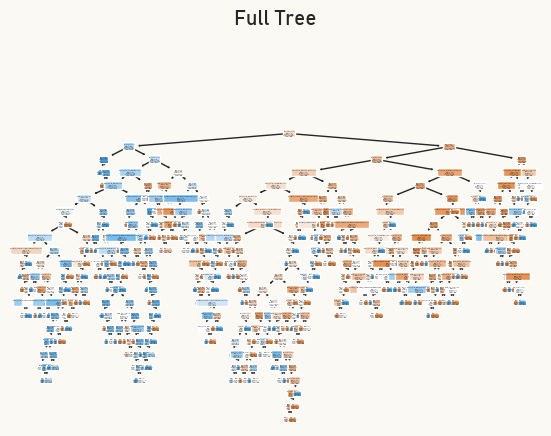

In [ ]:
myfont = "Bahnschrift"
fig, ax = plt.subplots()
fig.set_facecolor(BG_WHITE)
features = X.columns
ax = tree.plot_tree(clf_full, feature_names=features, class_names=classes, filled=True)
fig.suptitle("Full Tree", fontfamily=myfont, fontsize=15)

fig.tight_layout()

save_fig_custom(pic_name="dt_full", foldertosave="decision_tree", fmt="pdf")

### Pre-prunning 

In [ ]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

params = {
    "max_depth": [2, 4, 6, 8, 10, 12],
    "min_samples_split": [2, 3, 4],
    "min_samples_leaf": [1, 2, 3],
}

clf = tree.DecisionTreeClassifier(random_state=0)
gcv = GridSearchCV(estimator=clf, param_grid=params)
gcv.fit(X_train, y_train)

print(gcv.best_estimator_)

DecisionTreeClassifier(max_depth=2, random_state=0)


In [ ]:
clf_pre = gcv.best_estimator_
clf_pre.fit(X_train, y_train)

y_pred = clf_pre.predict(X_test)
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.6991404011461319


The graph was saved into d:\python\bank-segmentation\decision_tree


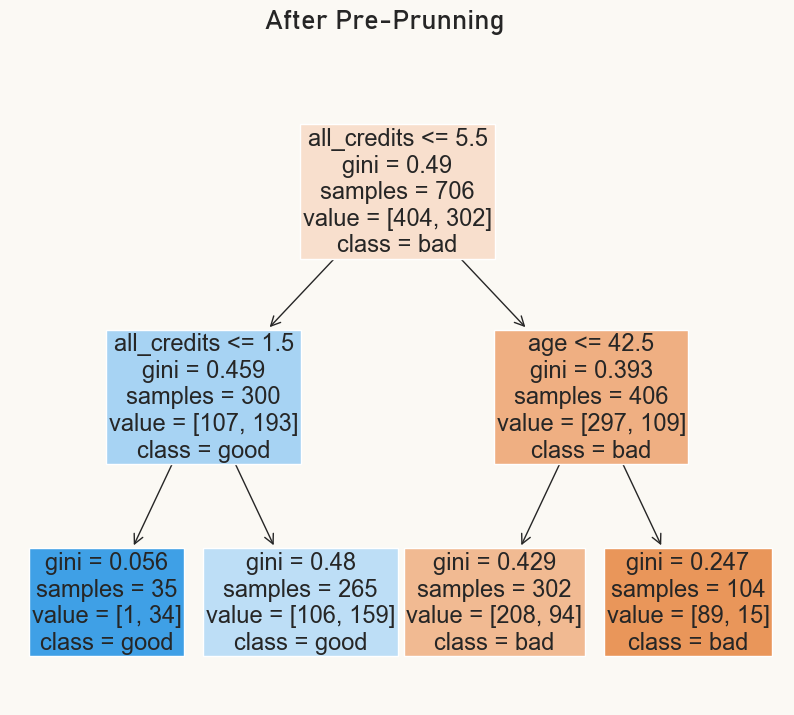

In [ ]:
myfont = "Bahnschrift"
fig, ax = plt.subplots(figsize=(10, 8))
fig.set_facecolor(BG_WHITE)
features = X.columns
ax = tree.plot_tree(clf_pre, feature_names=features, class_names=classes, filled=True)
fig.suptitle("After Pre-Prunning", fontfamily=myfont, fontsize=20)

save_fig_custom(pic_name="dt_pre_prunning", foldertosave="decision_tree", fmt="pdf")

### Description of Segments (DT, Pre-Prunning)

- Group 1: People with 1 loan 
- Group 2: People with 2,3,4,5 loans 
- Group 3: People with 6 or more loans with age less or equal to 42
- Group 4: People with 6 or more loans with age more than 42


### Post-prunning

In [ ]:
clf = DecisionTreeClassifier(random_state=0)
path = clf.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

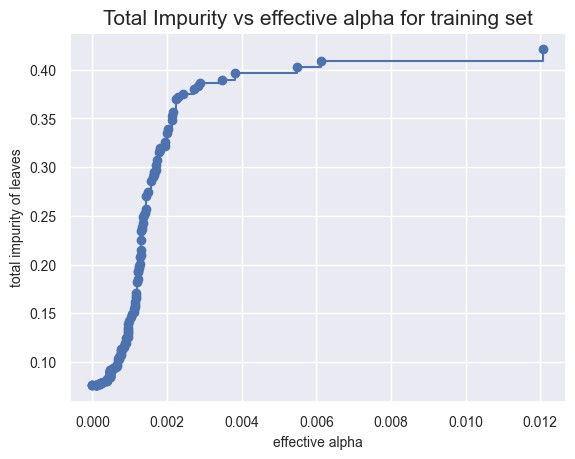

In [ ]:
fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha", fontsize=10)
ax.set_ylabel("total impurity of leaves", fontsize=10)
ax.set_title("Total Impurity vs effective alpha for training set", fontsize=15)

ax.tick_params(axis="both", which="major", labelsize=10)

In [ ]:
clfs = []
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=0, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs.append(clf)
print(
    "Number of nodes in the last tree is: {} with ccp_alpha: {}".format(
        clfs[-1].tree_.node_count, ccp_alphas[-1]
    )
)

Number of nodes in the last tree is: 1 with ccp_alpha: 0.06867632904823151


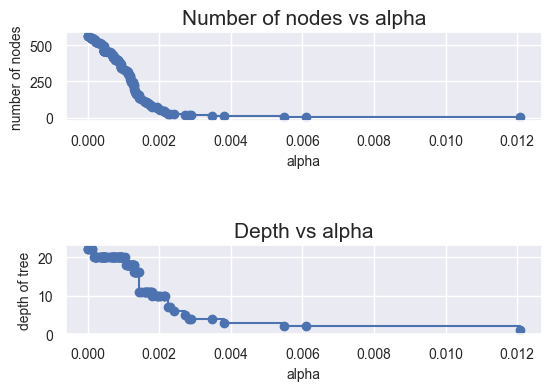

In [ ]:
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]

node_counts = [clf.tree_.node_count for clf in clfs]
depth = [clf.tree_.max_depth for clf in clfs]
fig, ax = plt.subplots(2, 1)
ax[0].plot(ccp_alphas, node_counts, marker="o", drawstyle="steps-post")
ax[0].set_xlabel("alpha", fontsize=10)
ax[0].set_ylabel("number of nodes", fontsize=10)
ax[0].set_title("Number of nodes vs alpha", fontsize=15)
ax[0].tick_params(axis="both", which="major", labelsize=10)

ax[1].plot(ccp_alphas, depth, marker="o", drawstyle="steps-post")
ax[1].set_xlabel("alpha", fontsize=10)
ax[1].set_ylabel("depth of tree", fontsize=10)
ax[1].set_title("Depth vs alpha", fontsize=15)
ax[1].tick_params(axis="both", which="major", labelsize=10)
fig.tight_layout()

The graph was saved into d:\python\bank-segmentation\decision_tree


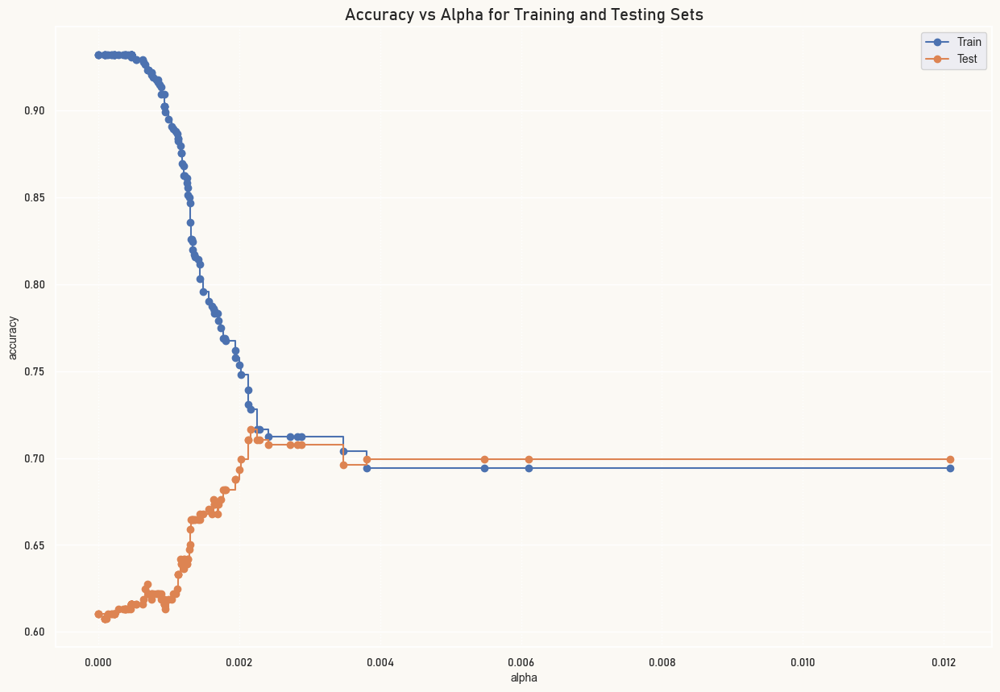

In [ ]:
train_scores = [clf.score(X_train, y_train) for clf in clfs]
test_scores = [clf.score(X_test, y_test) for clf in clfs]

fig, ax = plt.subplots(figsize=(15, 10))
fig.set_facecolor(BG_WHITE)
ax.set_xlabel("alpha", fontsize=10)
ax.set_ylabel("accuracy", fontsize=10)
ax.set_title(
    "Accuracy vs Alpha for Training and Testing Sets", fontsize=15, fontfamily=myfont
)
ax.plot(ccp_alphas, train_scores, marker="o", label="Train", drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker="o", label="Test", drawstyle="steps-post")
ax.tick_params(axis="both", which="major", labelsize=10)
ax.set_facecolor(BG_WHITE)
ax.grid(linestyle=":", axis="x")
ax.legend(fontsize=10)

for tick in ax.get_xticklabels():
    tick.set_fontname(myfont)
for tick in ax.get_yticklabels():
    tick.set_fontname(myfont)

save_fig_custom(pic_name="accuracy_vs_alpha", foldertosave="decision_tree")

In [ ]:
# print(list(zip(ccp_alphas, train_scores)))
def getxformaxy(xvals, yvals):
    max_score = max(yvals)
    for el in zip(xvals, yvals):
        if el[1] == max_score:
            return el[0]
        else:
            pass


opt_x = getxformaxy(ccp_alphas, test_scores)

In [ ]:
clf_post = DecisionTreeClassifier(random_state=0, ccp_alpha=opt_x)

# Train decision tree classifier
post = clf_post.fit(X_train, y_train)

# Predict the response
y_pred = post.predict(X_test)

# Check model accuracy
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.7163323782234957


The graph was saved into d:\python\bank-segmentation\decision_tree


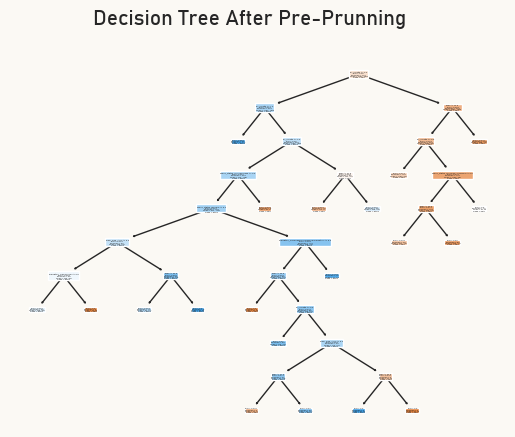

In [ ]:
myfont = "Bahnschrift"
fig, ax = plt.subplots()
fig.set_facecolor(BG_WHITE)
features = X.columns
ax = tree.plot_tree(clf_post, feature_names=features, class_names=classes, filled=True)
fig.suptitle("Decision Tree After Pre-Prunning", fontfamily=myfont, fontsize=15)

save_fig_custom(pic_name="dt_post_prunning", foldertosave="decision_tree", fmt="pdf")

### Description of Segments (DT, Post-Prunning)

'Good' segments:
- Group 1: People with 1 loan
- Group 2: People with 5 loans and age over 27.5
- Group 3: People with 2,3,4 loans, not in civil marriage or married, who earn more than 250 and their education level is not high school
- Group 4: People with 2,3,4 loans, not in civil marriage or married who earn less than 50 of age below or equal to 32
- Group 5: People with 2,3,4 loans, not in civil marriage or married who earn less than 50 of age over 32
- Group 6: Married people with 2,3,4 loans with secondary professional education
- Group 7: Married people with 2, 3 loans of age over 25.5 and whose education level is not secondary professional
- Group 8: Married people with 4 loans, not secondary professional education, who earn more than 250 of age greater than 27
- Group 9: Married people with 4 loans, not secondary professional education, who earn less than 50 of age less or equal to 27
 - Group 10: People with 5 loans with age greater than 27

'Bad' segments:
- Group 1: People with 2,3,4 loans, not in civil marriage or marriage, who earn more than 250 and have high school education
- Group 2: Married people with 2,3,4 loans with not secondary professional education of age less or equal to 25
- Group 3: Married people with 4 loans whose education level is not secondary professional of age less or equal to 27 and who earn over 250
- Group 4: Married people with 4 loans whose education level is not secondary professional of age over 32 and who earn less than 50
- Group 5: People with 6 to 9 loans of age less or equal to 42
- Group 6: People with 10 or more loans of age less or equal to 30, whose family status is not divorced
- Group 7: People with 10 or more loans whose age is between 31 and 42 and whose family status is not divorced
- Group 8: People with 6 or more loans of age greater than 42
- Group 9: Divorced people with 10 or more loans of age less or equal to 42